In [1]:
# Imports
from importlib import reload
from matplotlib.backends.backend_pdf import PdfPages
from scipy import sparse
from scipy import stats
from sklearn import neighbors
from sklearn.decomposition import PCA
from sklearn.feature_selection import f_regression
from sklearn.linear_model import LinearRegression
from sklearn.manifold import TSNE
import sklearn
from sklearn.metrics import pairwise_distances
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import cosine_distances
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.neighbors import BallTree
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.preprocessing import KBinsDiscretizer
from umap import UMAP
import anndata as ad
import json
import math
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import polars as pl
import polars.selectors as cs
import scanpy as sc
import seaborn as sns
import sklearn as sk
import statsmodels.api as sm
import sys
import typing
import umap
import warnings
import re

from importlib import reload
warnings.filterwarnings('ignore')



from scipy.spatial.distance import cosine
from scipy.stats import pearsonr


import toolz
from toolz import curry
from scipy.stats import mannwhitneyu, brunnermunzel
from sklearn.metrics.pairwise import pairwise_kernels
import scipy
import time
from scipy import linalg
import matplotlib

class mplDeprecation(UserWarning):
    pass

matplotlib.cbook.mplDeprecation = mplDeprecation

import scvelo as scv

from scipy.sparse.csgraph import shortest_path

import simutils


plt.ion()

### set random seed
np.random.seed(42)

/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound


### Simulation of cell trajectory
reload(simutils)
sc.set_figure_params(dpi=60,) #keep the notebook compact

In [2]:
import os
sc.set_figure_params(dpi=60,) #keep the notebook compact
save_dir = "./plots/simulation/"
save_dir = os.path.abspath(save_dir)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
print(save_dir, os.path.exists(save_dir))

/home/zelhar/my_gits/exovelo_paper/code/plots/simulation True


In [3]:
dt = 0.05
ticks = [0,4,2,0,8,0,1,5,0]
a = np.repeat(
    ticks,
    [20,]*len(ticks),
)
r0=0
n = len(a) + 1
g = 0.75
b = 3.0
t = np.cumsum(np.repeat((0,dt), (1,n-1)))

In [4]:
n_genes=30
n_repeats=50
adata = simutils.simulateGenes(n_genes=n_genes, n_repeats=n_repeats, a=a, b=b, g=g, s0=0, u0=0, n=n, dt=dt, zinf=0.2, dif=1e-4, rscale=False, rate_distort=True)
adata = adata[adata.obs['time'] > 2.0].copy()
adata.obs['time'] = adata.obs['time'] - adata.obs['time'].min()
adata

AnnData object with n_obs × n_vars = 7000 × 30
    obs: 'time'
    layers: 'spliced', 'total', 'unspliced'

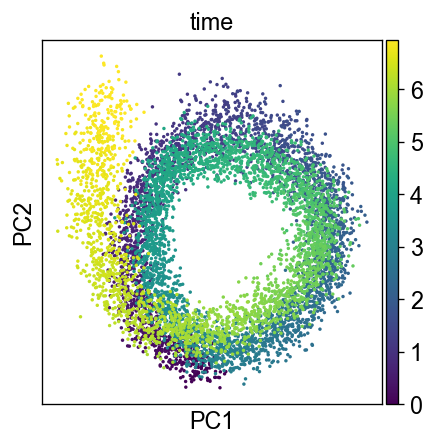

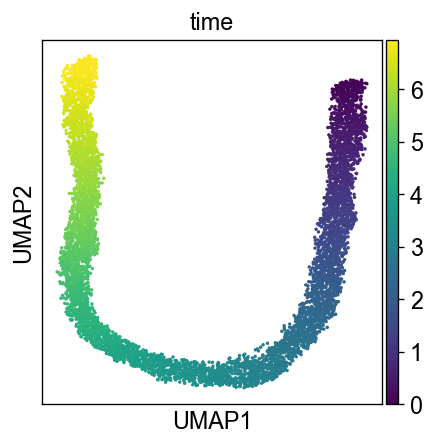

In [5]:
adata.layers['v'] = np.zeros_like(adata.layers['spliced'])
adata.layers['v'][10:] = adata.layers['spliced'][10:] - adata.layers['spliced'][:-10]

sc.pp.filter_cells(adata, min_genes=5)
sc.pp.scale(adata,)
sc.pp.pca(adata)

sc.pp.neighbors(adata, n_neighbors=15)
sc.tl.umap(adata,)

sc.pl.pca(adata, color='time')
sc.pl.umap(adata, color='time')

computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 15/20 cores)


  0%|          | 0/30 [00:00<?, ?gene/s]

/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound
/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound
/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html.

    finished (0:00:03) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 15/20 cores)


  0%|          | 0/7000 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


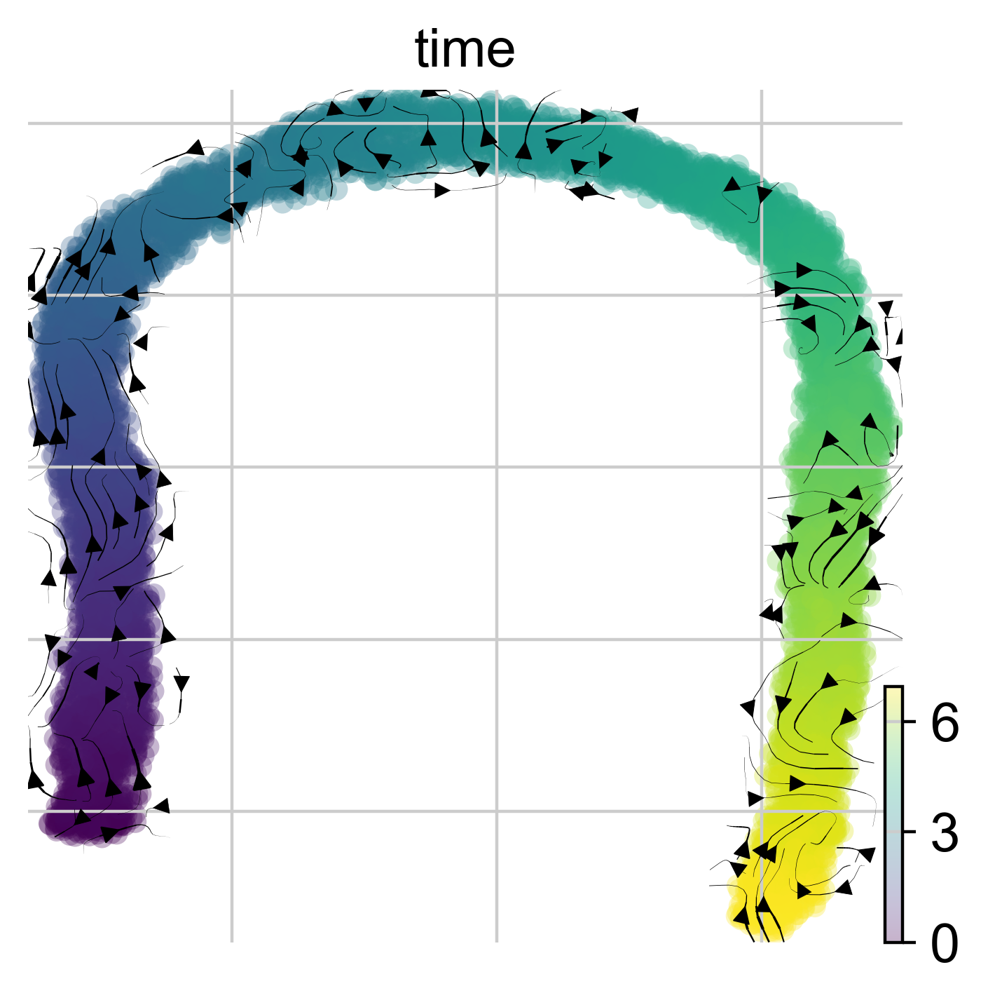

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


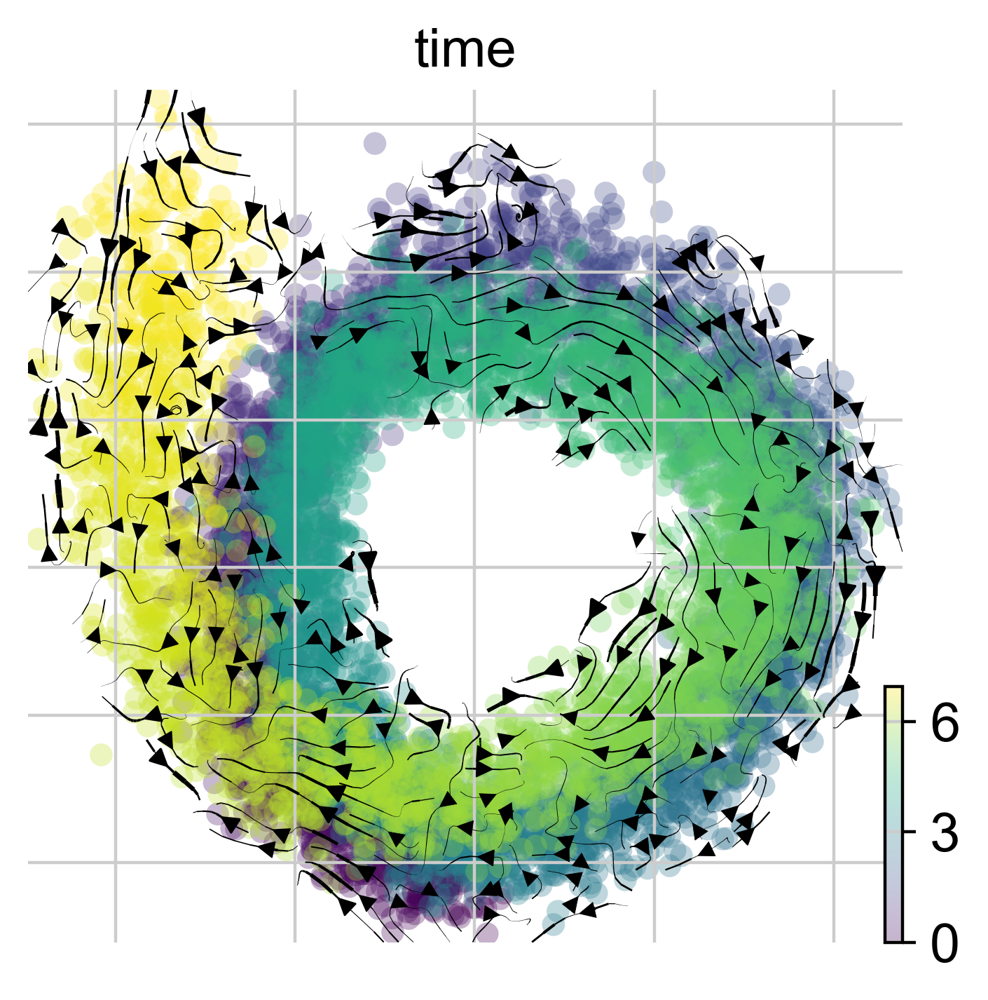

In [6]:
adata2 = adata.copy()
sc.pp.scale(adata2)
sc.pp.pca(adata2,)
sc.pp.neighbors(adata2, n_neighbors=20)

scv.pp.moments(adata2, n_pcs=None, n_neighbors=20)
scv.tl.recover_dynamics(adata2, n_jobs=15)
scv.tl.velocity(adata2, )
scv.tl.velocity_graph(adata2, n_jobs=15)

sc.tl.umap(adata2,)
scv.pl.velocity_embedding_stream(adata2, basis='umap', color='time', dpi=200)
scv.pl.velocity_embedding_stream(adata2, basis='pca', color='time', dpi=200)

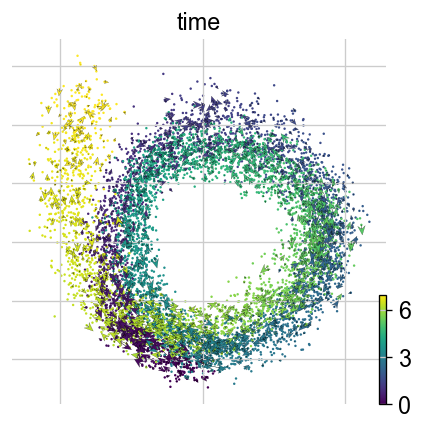

In [7]:
scv.pl.velocity_embedding(adata2, basis='pca', color='time', arrow_size=4, arrow_length=5, dpi=60, density=0.252, show=True, color_map='viridis', colorbar=True, alpha=1)

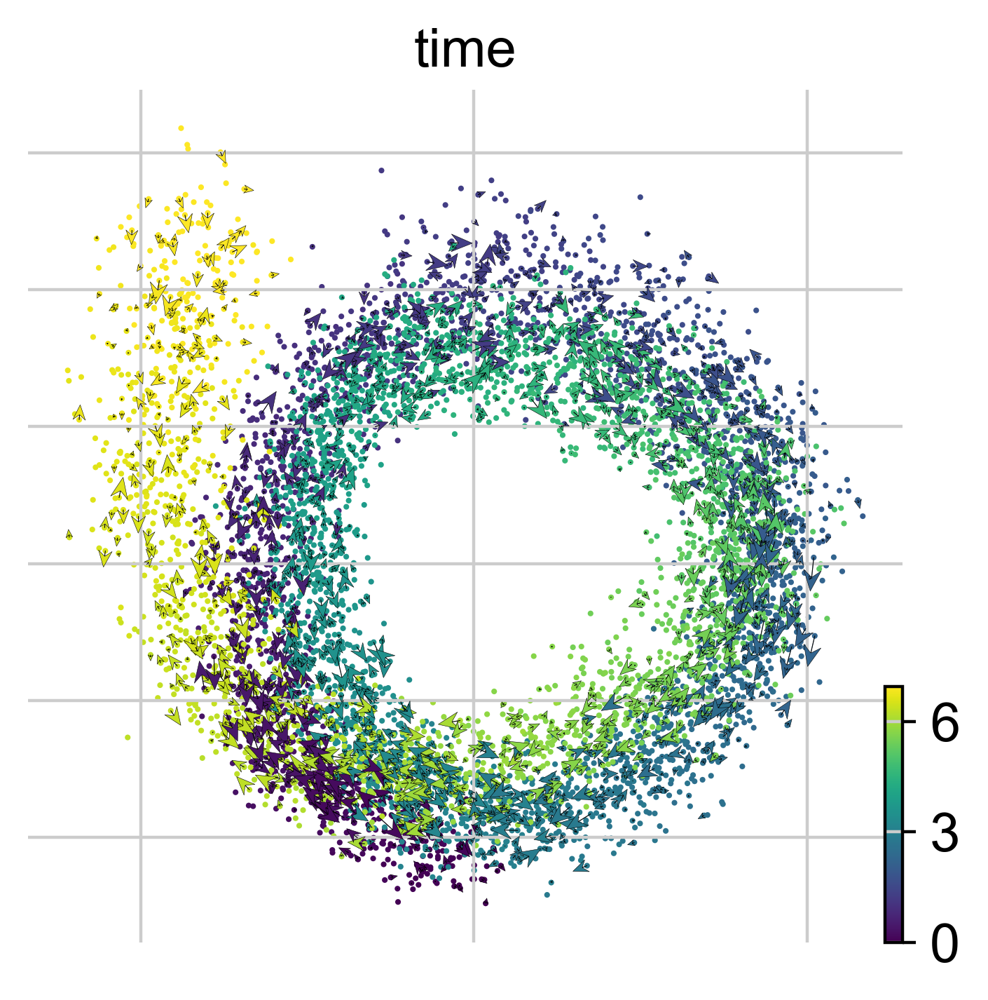

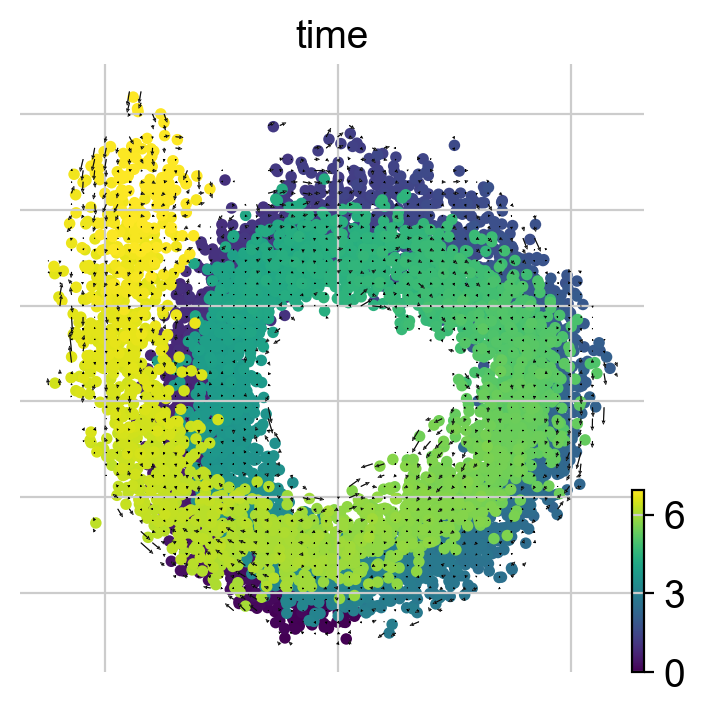

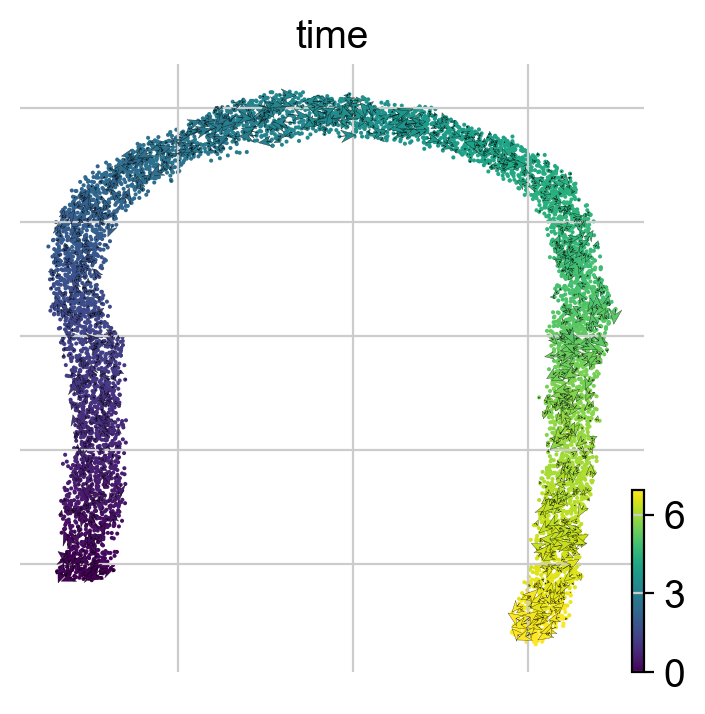

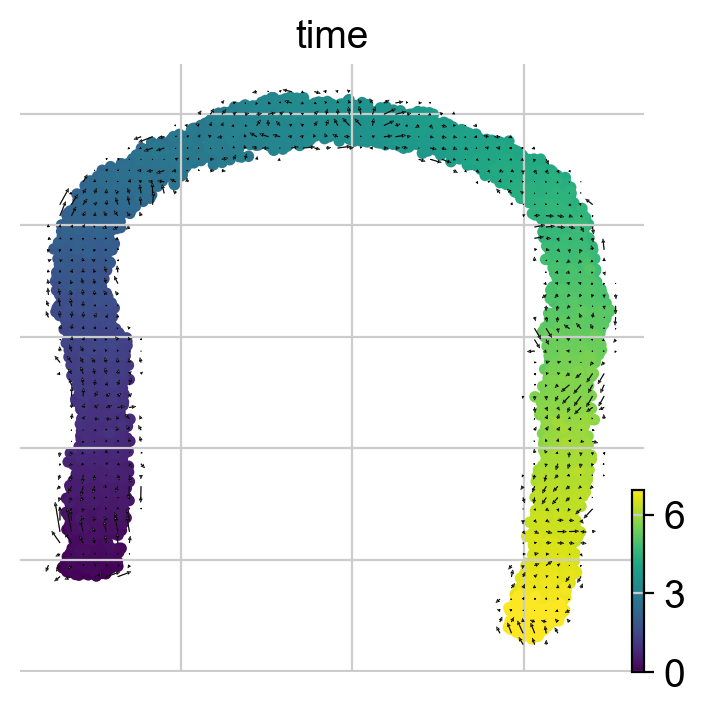

In [8]:
scv.pl.velocity_embedding(adata2, basis='pca', color='time', arrow_size=4, arrow_length=5, dpi=200, density=0.252, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_pca_scvelo.pdf", dpi=100, bbox_inches='tight', backend='cairo', transparent=True,)
scv.pl.velocity_embedding_grid(adata2, basis='pca', color='time', dpi=100, density=1.0, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_pca_grid_scvelo.pdf", dpi=100, bbox_inches='tight', backend='cairo', transparent=True,)
scv.pl.velocity_embedding(adata2, basis='umap', color='time', arrow_size=4, arrow_length=5, dpi=100, density=0.152, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umap_scvelo.pdf", dpi=100, bbox_inches='tight', backend='cairo', transparent=True,)
scv.pl.velocity_embedding_grid(adata2, basis='umap', color='time', dpi=100, density=1.0, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umap_grid_scvelo.pdf", dpi=100, bbox_inches='tight', backend='cairo', transparent=True,)

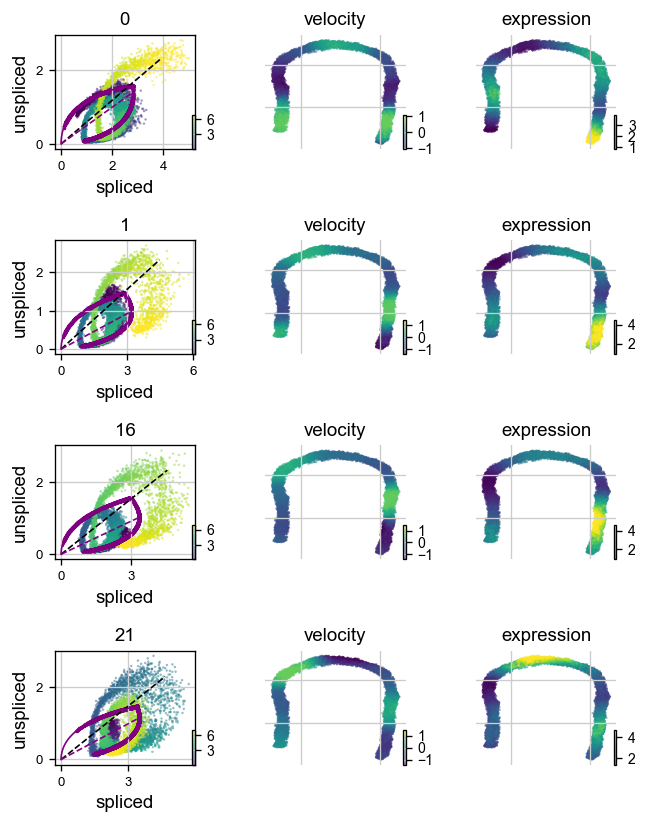

In [12]:
scv.pl.velocity(adata2, var_names=['0', '1', '16','21'], dpi=60, color='time', color_map='viridis')

In [13]:
adata2.var[:2]

,mean,std,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,...,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,velocity_gamma,velocity_qreg_ratio,velocity_r2,velocity_genes
0,-5.830891e-15,1.0,0.299148,0.846738,0.528906,0.262444,11.774080,0.674117,0.596723,0.677418,...,0.0,0.444108,1.414916,2.702057,0.923457,2.451385,0.589838,0.589838,0.001218,False
1,3.357219e-15,1.0,0.266591,1.289477,0.717330,0.220934,7.214224,0.329016,0.576299,0.827623,...,0.0,0.478261,1.346753,2.951071,0.974851,1.906676,0.520292,0.520292,-0.117526,False


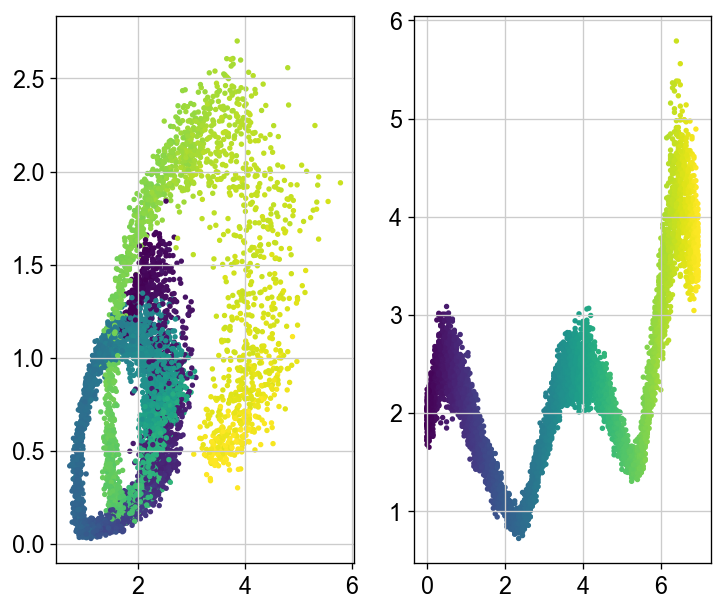

In [15]:
fig, ax = plt.subplots(dpi=60, figsize=(7,6), nrows=1, ncols=2)
#ax.scatter(Xp[:,0], Yp[:,0], c=adata.obs['time'], s=5,)
#ax.scatter(adata2.layers['spliced'][:,0], adata2.layers['unspliced'][:,0], c=adata.obs['time'], s=5,)
j=1
ax[0].scatter(adata2.layers['Ms'][:,j], adata2.layers['Mu'][:,j], c=adata.obs['time'], s=5,)
ax[1].scatter(adata2.obs['time'], adata2.layers['Ms'][:,j], c=adata.obs['time'], s=5,)

In [16]:
X = adata.layers['spliced'].copy()
Y = adata.layers['total'].copy()
X = StandardScaler().fit_transform(X)
Y = StandardScaler().fit_transform(Y)
n_comps = 6
pca = PCA(n_components=n_comps).fit(X)
Xp = pca.transform(X)
Yp = pca.transform(Y)

k=8 #default
tree = BallTree(Xp, metric='minkowski', p=2)
dist, ind = tree.query(Xp, k=k)
Z = X + (Y - X)[ind].mean(1)
Zp = pca.transform(Z)

[]

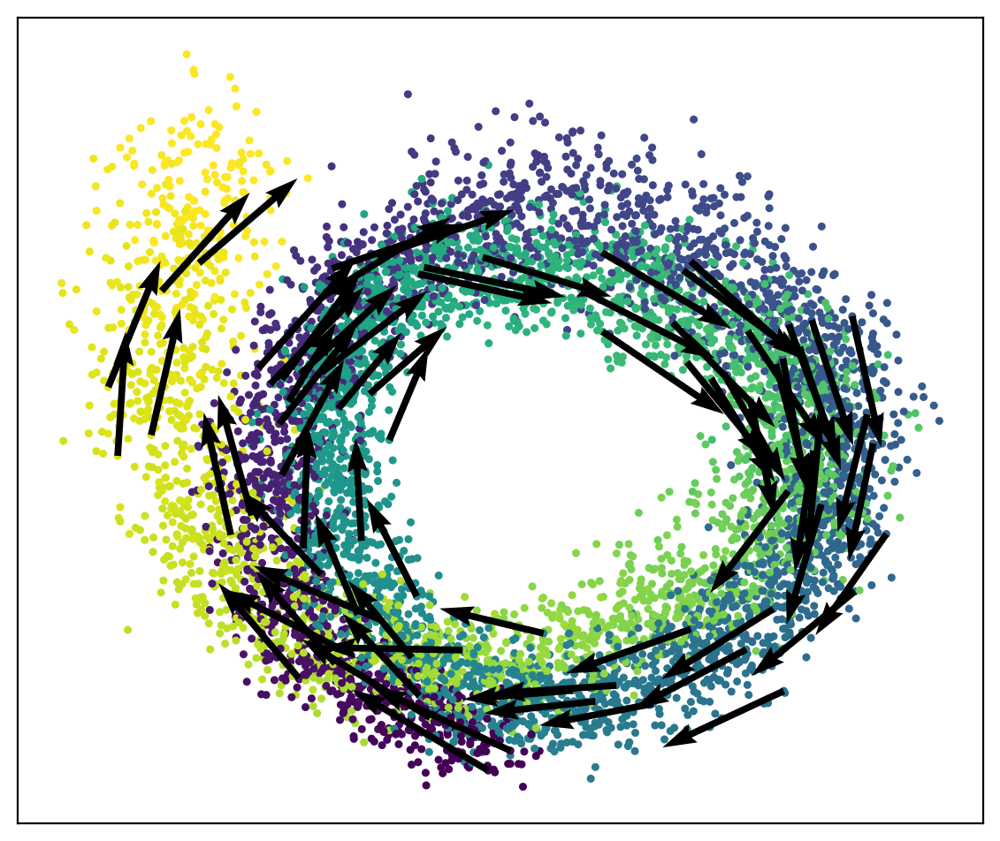

In [17]:
mask = np.random.rand(len(Xp)) >= 0.0
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(Xp[:,0][mask], Xp[:,1][mask], c=adata.obs['time'][mask], s=5,)
mask = np.random.rand(len(Xp)) < 1e-2
ax.quiver(
    Xp[:, 0][mask],
    Xp[:, 1][mask],
    (Zp - Xp)[:, 0][mask],
    (Zp - Xp)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    #width=3e-3,
    #headwidth=6,
    #headlength=6,
)

ax.set_xticks([])
ax.set_yticks([])

In [18]:
adata.n_obs / n_repeats, 140 * 50, adata.n_obs

(140.0, 7000, 7000)

In [19]:
iss = np.array([i for i in range(adata.n_obs) if i % 140 < 130])
jss = iss + 5
iss.shape

(6500,)

In [20]:
v_true = Xp[jss] - Xp[iss]
v_est = Yp[iss] - Xp[iss]
v_est = Zp[iss] - Xp[iss]
v_true.shape

(6500, 6)

In [21]:
## cosine similarity
cosine([1,1], [-1,-1])
1 - cosine(v_true[0], v_est[0])
mean_cosine_similarity = ( (v_est * v_true).sum(1) / linalg.norm(v_est, axis=1, ord=2) /linalg.norm(v_true, axis=1, ord=2 )).mean()
print(f"mean cosine similarity = {mean_cosine_similarity}")

mean cosine similarity = 0.8326953916923546


In [22]:
#pearson R
correlation_coefficient, p_val = pearsonr(v_true,v_est, axis=1)
print(f"mean Pearson's R = {correlation_coefficient.mean()} mean p_val={p_val}")

mean Pearson's R = 0.8337226038026303 mean p_val=[0.00067607 0.0034846  0.00794616 ... 0.00177155 0.05423721 0.02429033]


In [23]:
#pearson R
correlation_coefficient, p_val = pearsonr(v_true,v_est, axis=1)
print(f"mean Pearson's R = {correlation_coefficient.mean()} mean p_val={p_val.mean()}")

mean Pearson's R = 0.8337226038026303 mean p_val=0.0616820409248672


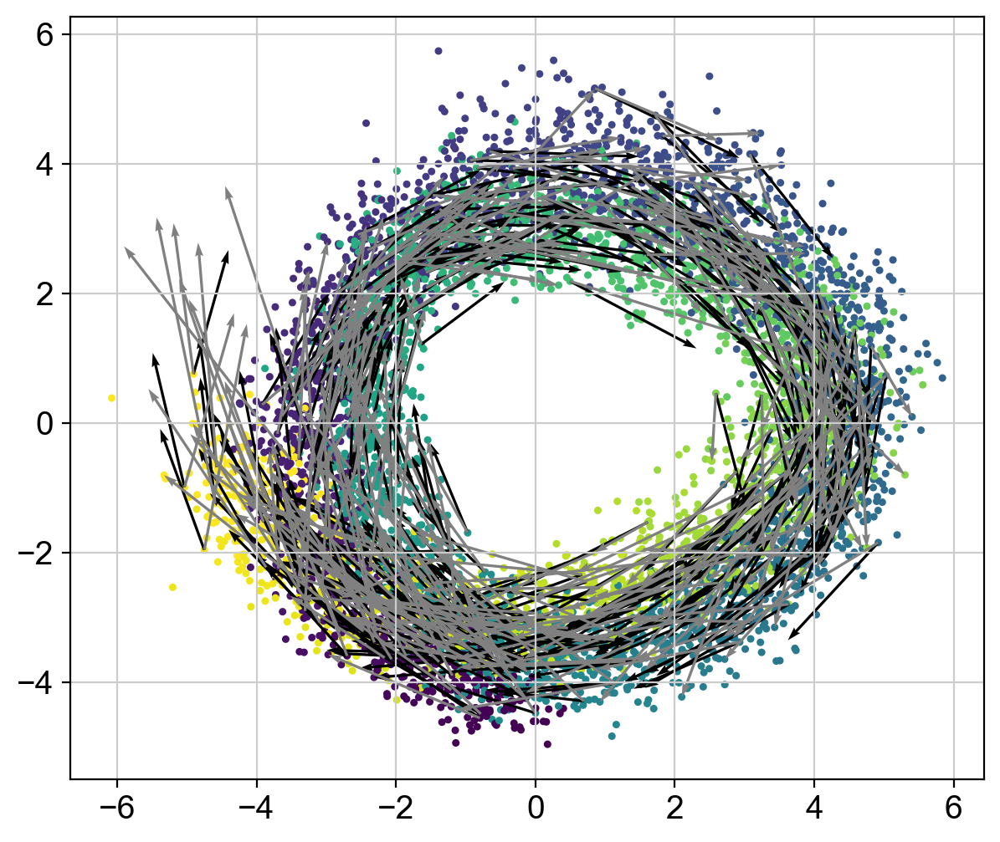

In [25]:
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(Xp[:,0][iss], Xp[:,1][iss], c=adata.obs['time'][iss], s=5,)

mask = np.random.rand(len(iss)) < 5e-2
ax.quiver(
    Xp[:, 0][iss][mask],
    Xp[:, 1][iss][mask],
    (Zp - Xp)[:-5, 0][iss][mask],
    (Zp - Xp)[:-5, 1][iss][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)

#mask = np.random.rand(len(iss)) < 2e-2
ax.quiver(
    Xp[:, 0][iss][mask],
    Xp[:, 1][iss][mask],
    (Xp[jss] - Xp[iss])[:, 0][mask],
    (Xp[jss] - Xp[iss])[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="gray",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)

plt.savefig(f"{save_dir}/simulation_pca_real_and_est_velocities.pdf", dpi=300, bbox_inches='tight', backend='cairo', transparent=True,)

[]

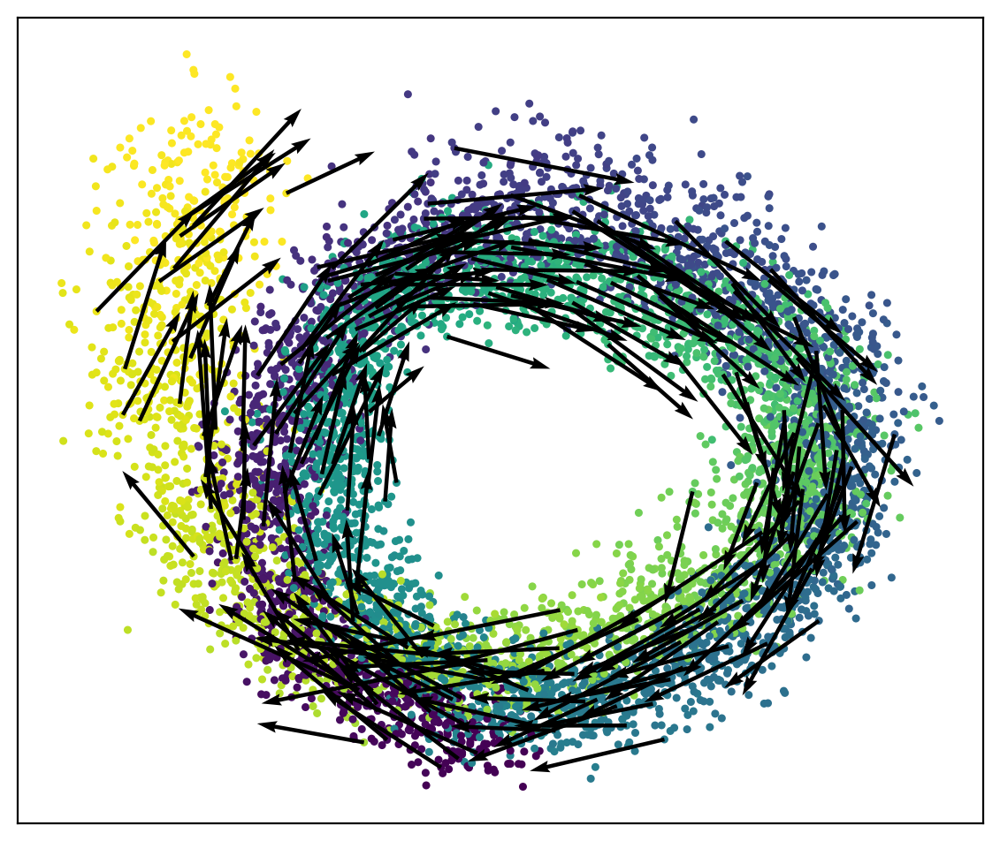

In [26]:
mask = np.random.rand(len(Xp)) >= 0.0
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(Xp[:,0][mask], Xp[:,1][mask], c=adata.obs['time'][mask], s=5,)
mask = np.random.rand(len(Xp)) < 3e-2
ax.quiver(
    Xp[:, 0][mask],
    Xp[:, 1][mask],
    (Yp - Xp)[:, 0][mask],
    (Yp - Xp)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    #width=3e-3,
    #headwidth=6,
    #headlength=6,
)
ax.set_xticks([])
ax.set_yticks([])

In [27]:
S = adata.layers['spliced'].copy()
U = adata.layers['unspliced'].copy()
T = adata.layers['total'].copy()
S = normalize(S, norm='l2', axis=1)
T = normalize(T, norm='l2', axis=1)
U = normalize(U, norm='l2', axis=1)
n_comps = 6
pca = PCA(n_components=n_comps).fit(S)
Sp = pca.transform(S)
Tp = pca.transform(T)
Up = pca.transform(U)

k=8 #default
tree = BallTree(Sp, metric='minkowski', p=2)
dist, ind = tree.query(Up, k=k)
dist, ind = tree.query(Tp, k=k)

[]

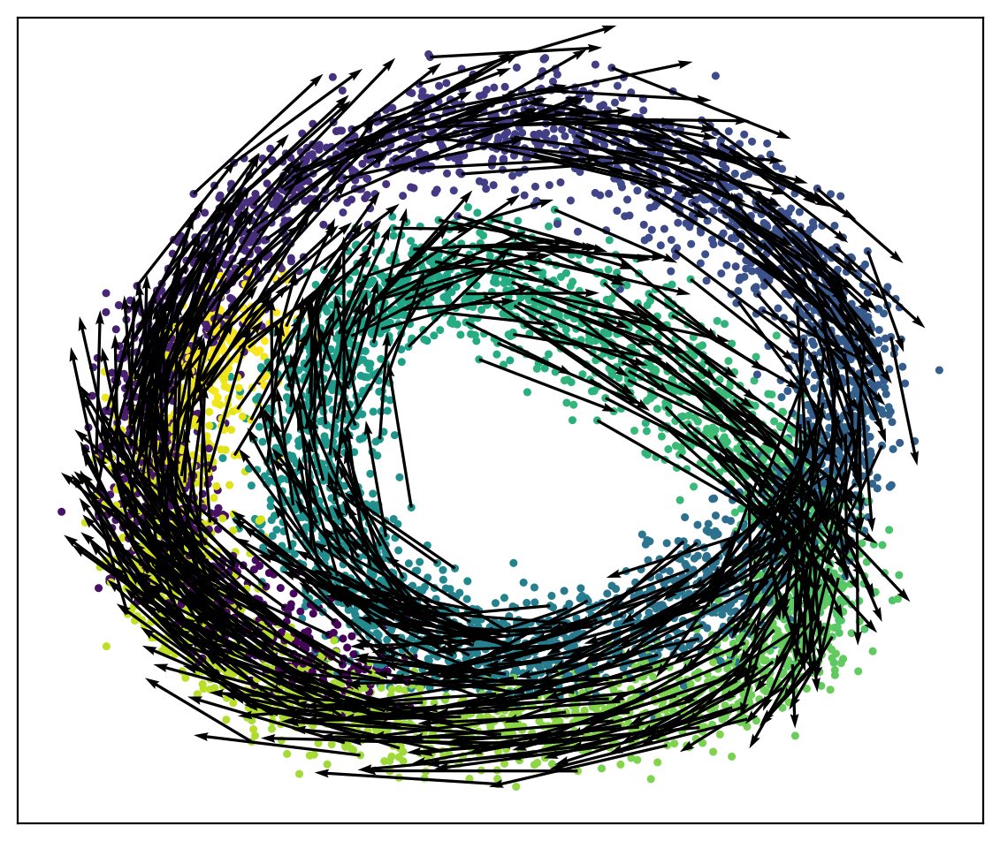

In [28]:
mask = np.random.rand(len(Xp)) >= 0
x = Sp
y = Up
y = Sp[ind].mean(1)
y = Tp
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
mask = np.random.rand(len(Xp)) < 1e-1
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    (y - x)[:, 0][mask],
    (y - x)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)
ax.set_xticks([])
ax.set_yticks([])

In [30]:
n_obs = adata.n_obs
reducer = UMAP(n_neighbors=25, init='pca', min_dist=1.25, spread=2).fit(np.concatenate((Xp,Zp), axis=0))
x = reducer.transform(Xp)
y = reducer.transform(Zp)

xdata = adata.copy()
xdata.obsm['X_umap2'] = reducer.transform(Xp)
xdata.obsm['velocity_umap2'] = reducer.transform(Zp) - reducer.transform(Xp)
xdata.obsm['X_pca2'] = Xp
xdata.obsm['velocity_pca2'] = Zp - Xp

[]

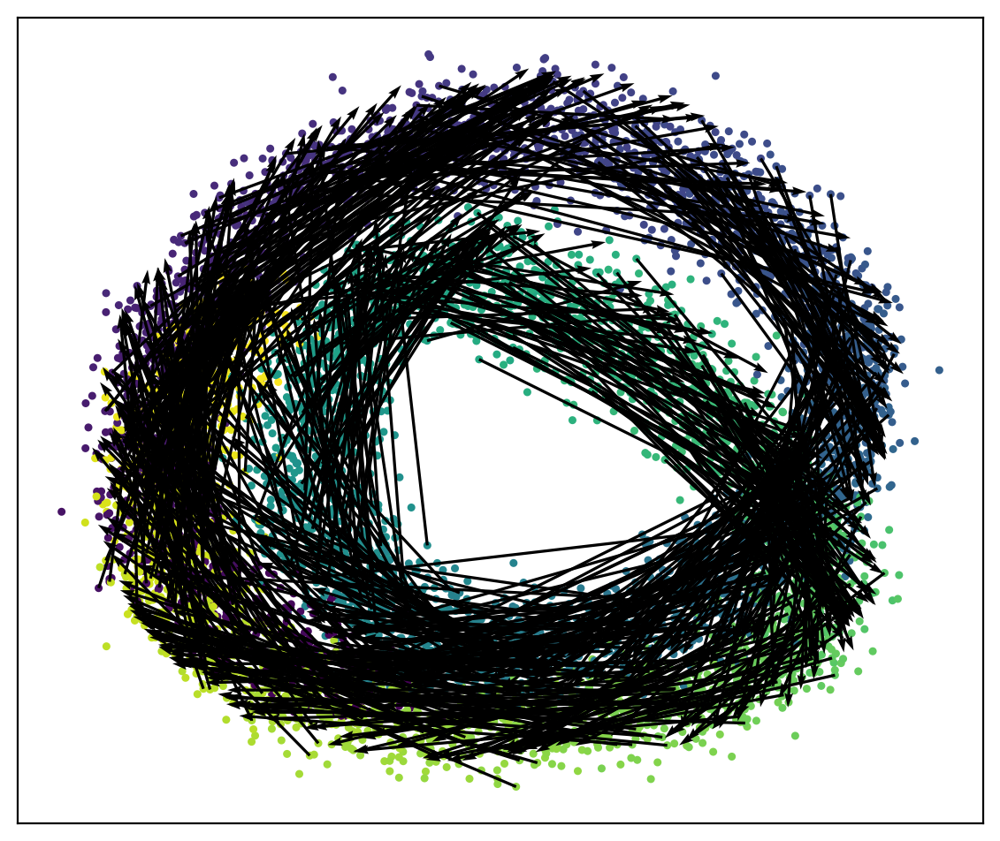

In [31]:
# eco-evol projection but with total RNA as future modality (instead of unspliced) 
mask = np.random.rand(len(Xp)) >= 0
x = Sp
y = Up
y = Tp
y = Sp[ind].mean(1)
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
#ax.scatter(Yp[:,0], Yp[:,1], s=5,)
#ax.colorbar(label='time')
#ax.legend()
mask = np.random.rand(len(Xp)) < 1e-1
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    (y - x)[:, 0][mask],
    (y - x)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)
ax.set_xticks([])
ax.set_yticks([])

[]

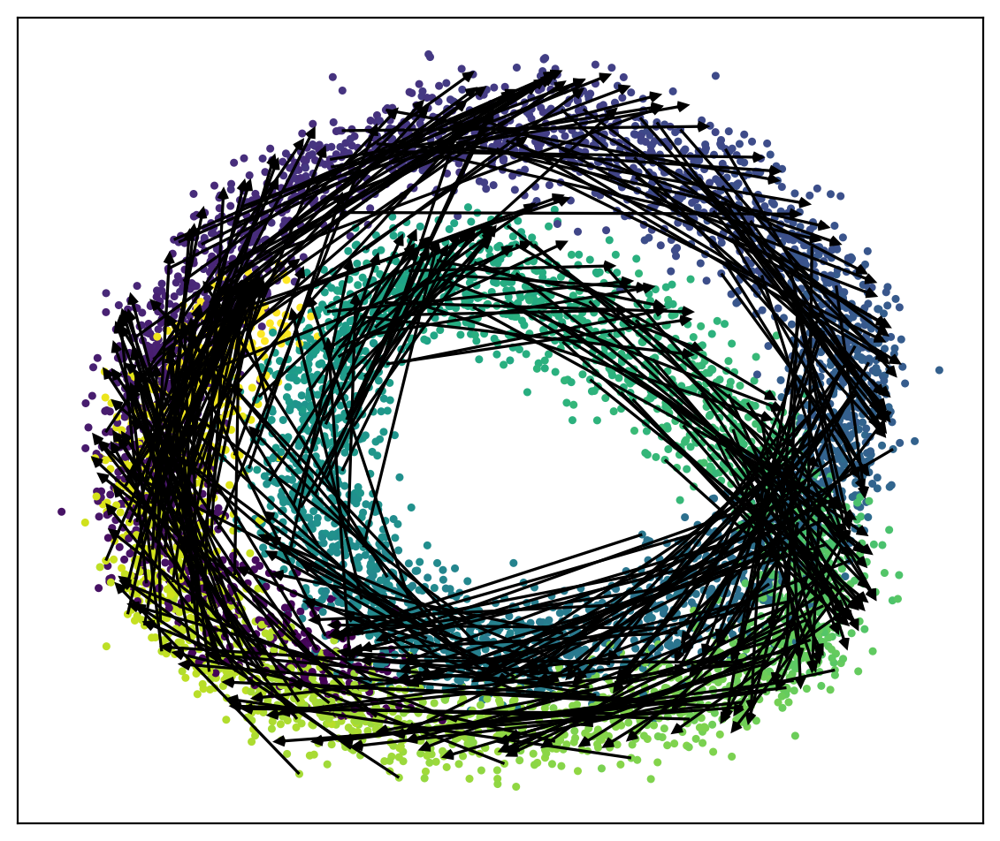

In [32]:
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
#ax.colorbar(label='time')
#ax.legend()
mask = np.random.rand(len(Xp)) < 5e-2
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    (y - x)[:, 0][mask],
    (y - x)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    width=3e-3,
    headwidth=4,
    headlength=4,
    scale=1,
)
ax.set_xticks([])
ax.set_yticks([])

<Axes: title={'center': 'time'}>

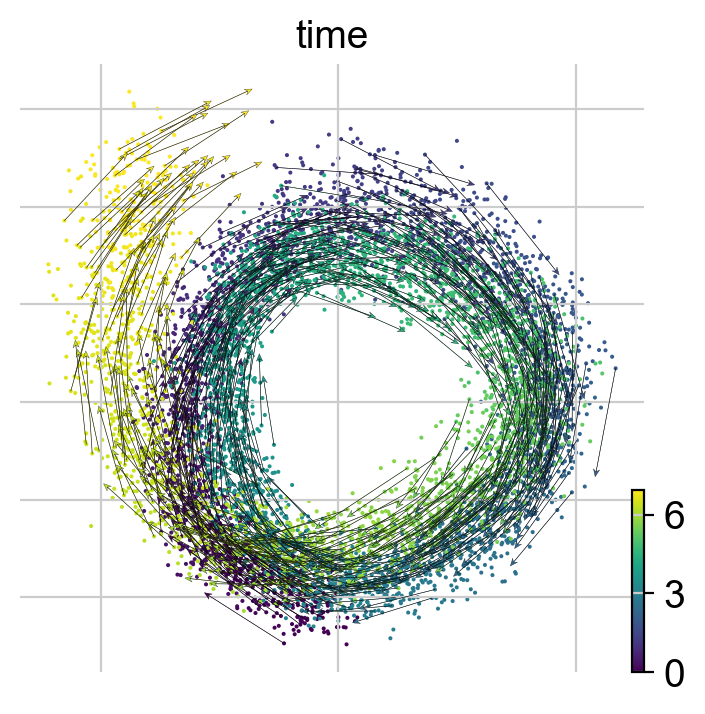

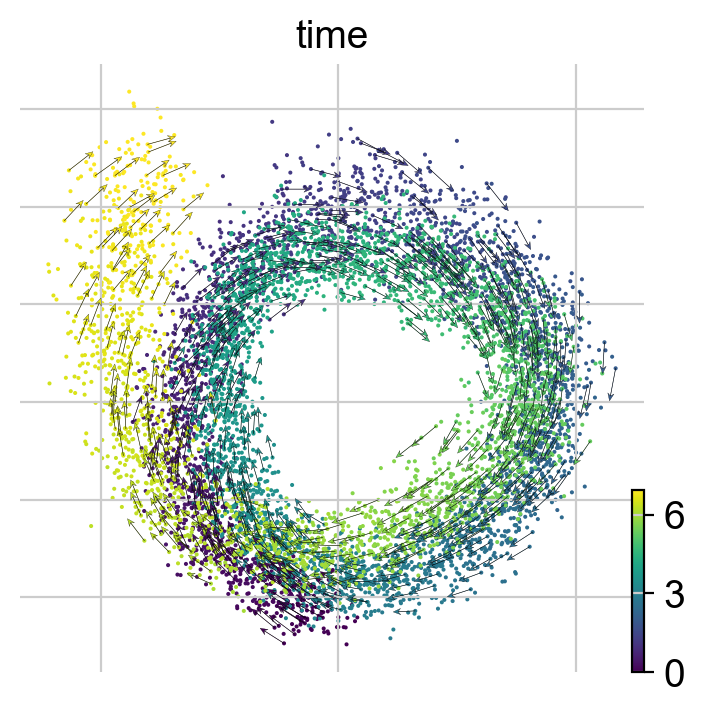

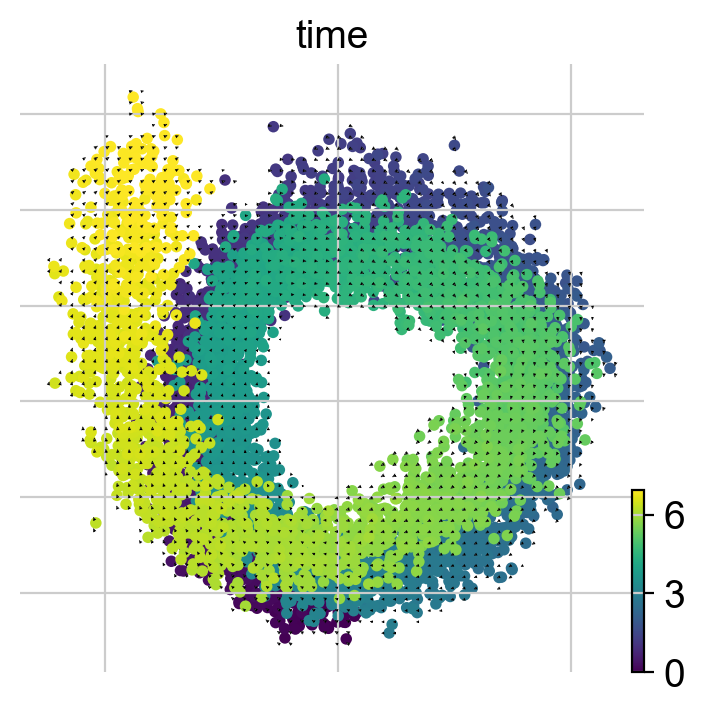

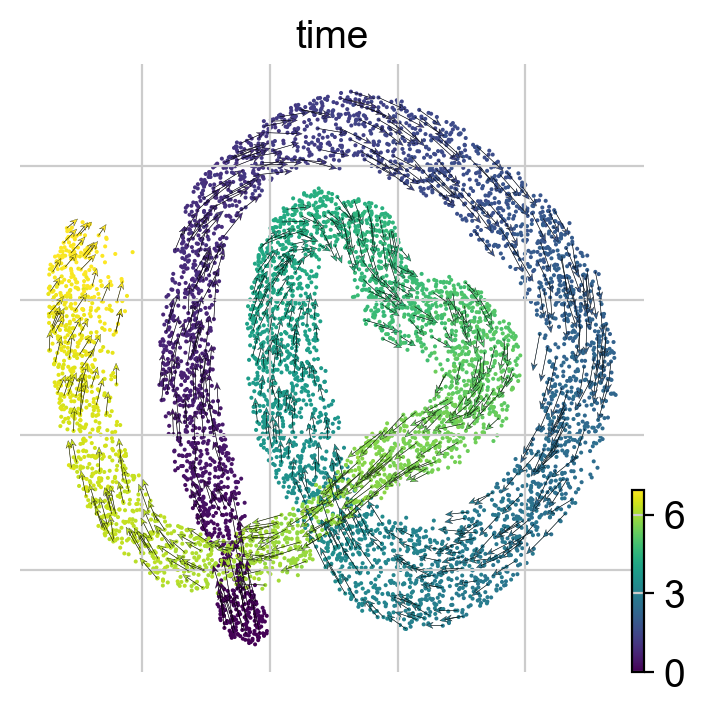

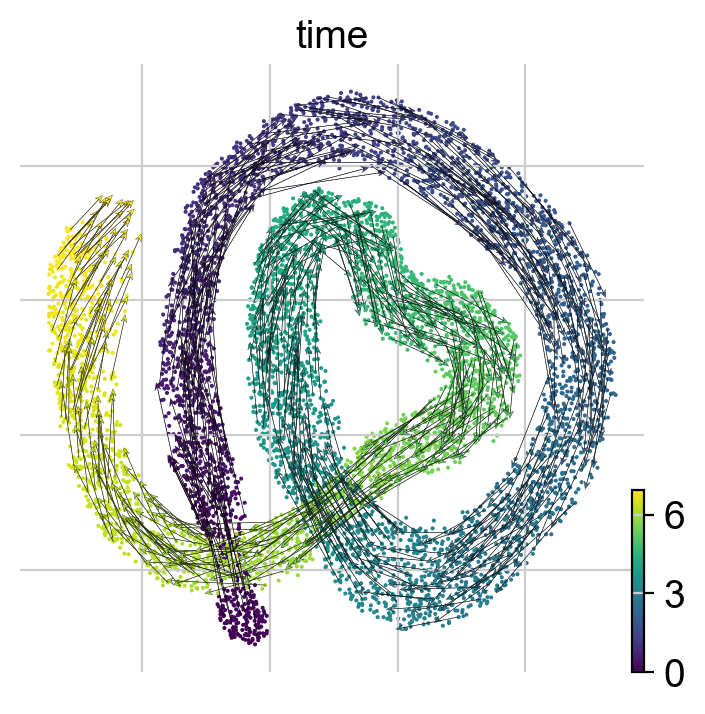

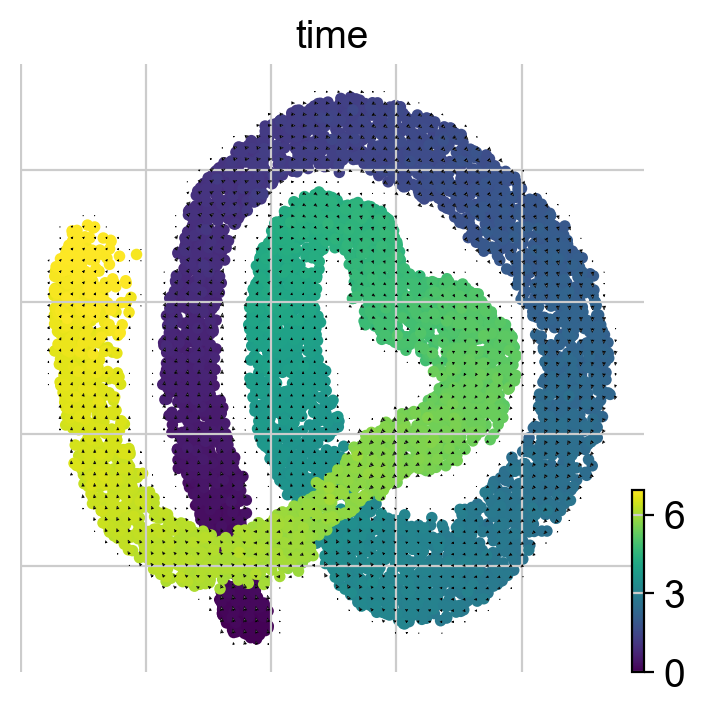

In [33]:
scv.pl.velocity_embedding(xdata, basis='pca2', color='time', dpi=100, density=0.1, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(xdata, basis='pca2', color='time', dpi=100, density=0.1, arrow_length=0.3, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_pca_exovelo.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(xdata, basis='pca2', color='time', dpi=100, density=1.0, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(xdata, basis='umap2', color='time', dpi=100, density=0.1, arrow_length=0.3, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(xdata, basis='umap2', color='time', dpi=100, density=0.1, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umap_exovelo.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(xdata, basis='umap2', color='time', dpi=100, density=1.0, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)

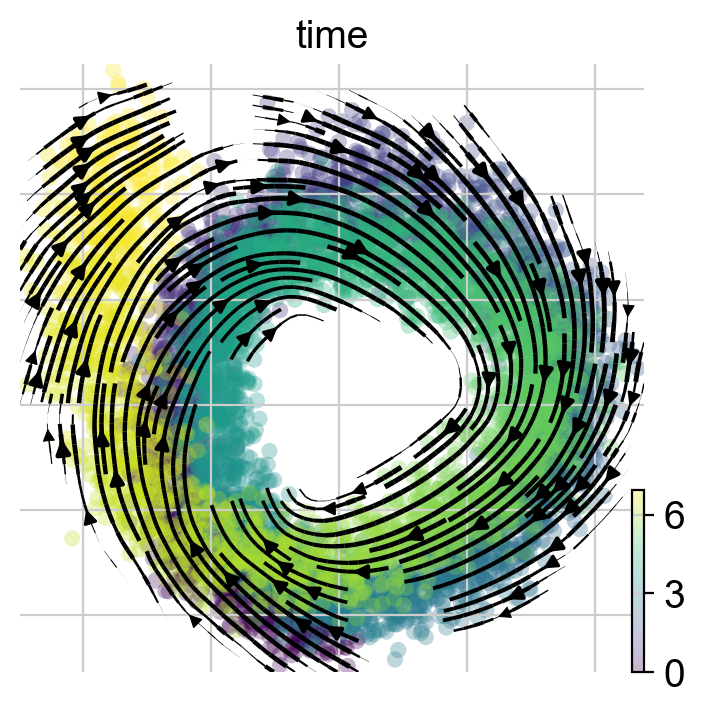

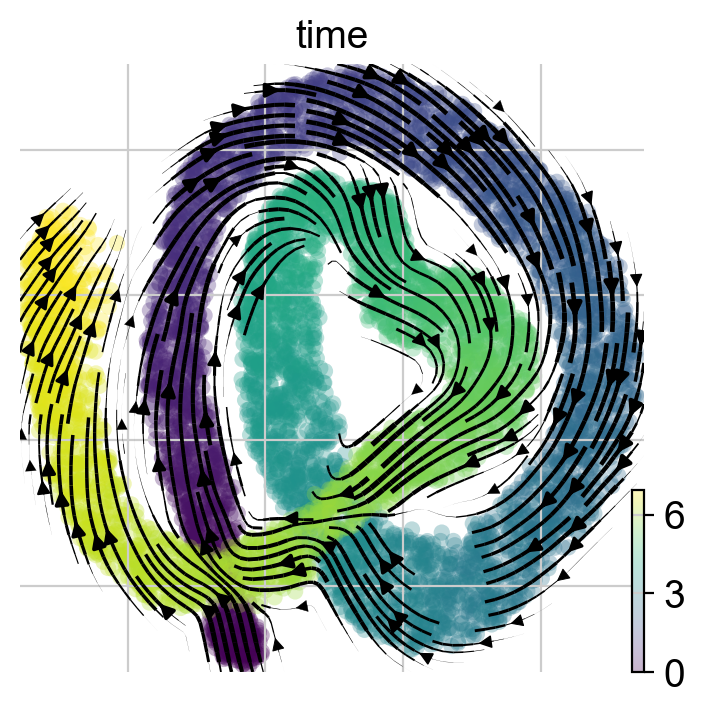

In [34]:
scv.pl.velocity_embedding_stream(xdata, basis='pca2', color='time', dpi=100, )
scv.pl.velocity_embedding_stream(xdata, basis='umap2', color='time', dpi=100, )

In [35]:
n_obs = adata.n_obs
reducer = UMAP(n_neighbors=20, init='pca', min_dist=0.25).fit(np.concatenate((Sp,Tp), axis=0))
x = reducer.transform(Sp)
y = reducer.transform(Tp)

ydata = adata.copy()
ydata.obsm['X_umap2'] = reducer.transform(Sp)
ydata.obsm['velocity_umap2'] = reducer.transform(Tp) - reducer.transform(Sp)
ydata.obsm['X_pca2'] = Sp
ydata.obsm['velocity_pca2'] = Tp - Sp

[]

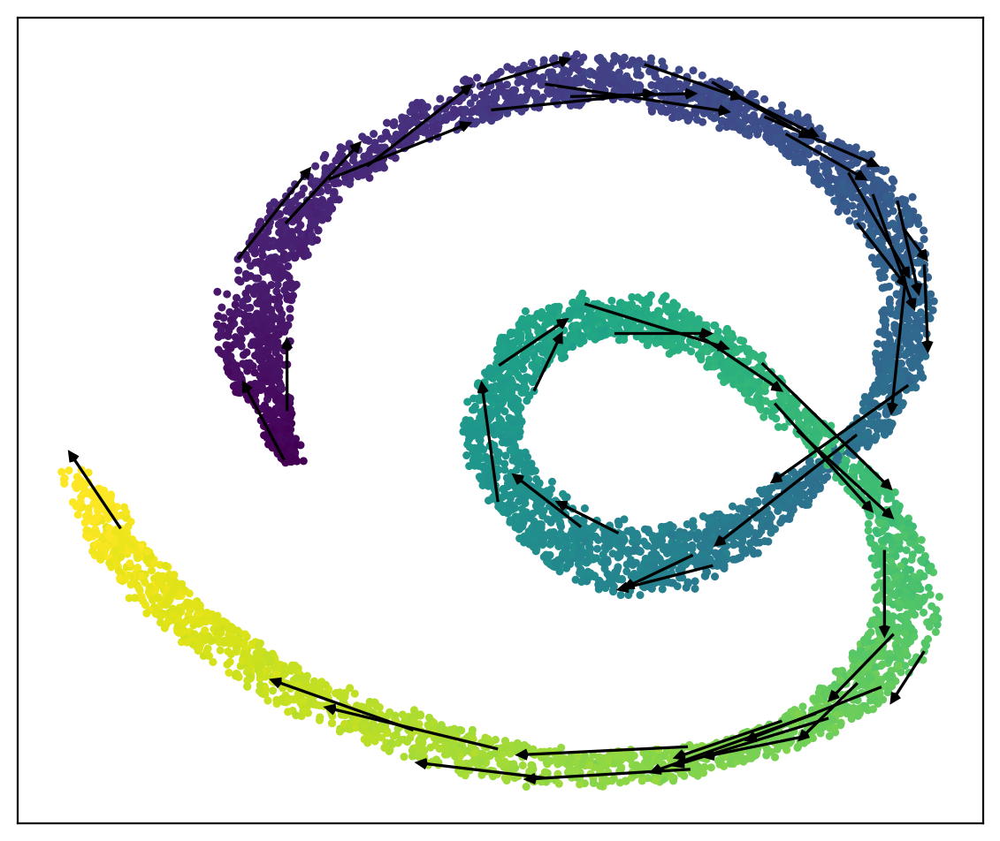

In [36]:
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
#ax.colorbar(label='time')
#ax.legend()
mask = np.random.rand(len(Xp)) < 1e-2
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    (y - x)[:, 0][mask],
    (y - x)[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    width=3e-3,
    headwidth=4,
    headlength=4,
    scale=1,
)
ax.set_xticks([])
ax.set_yticks([])

<Axes: title={'center': 'time'}>

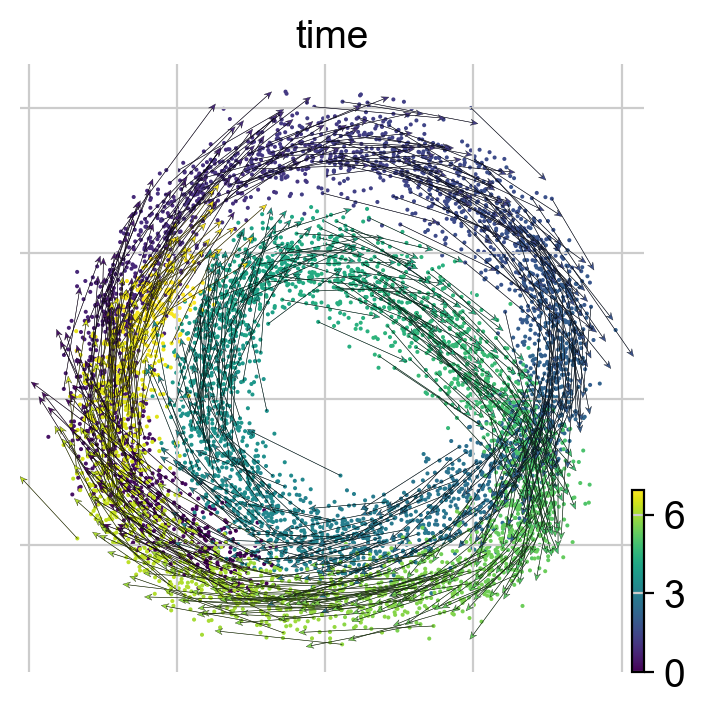

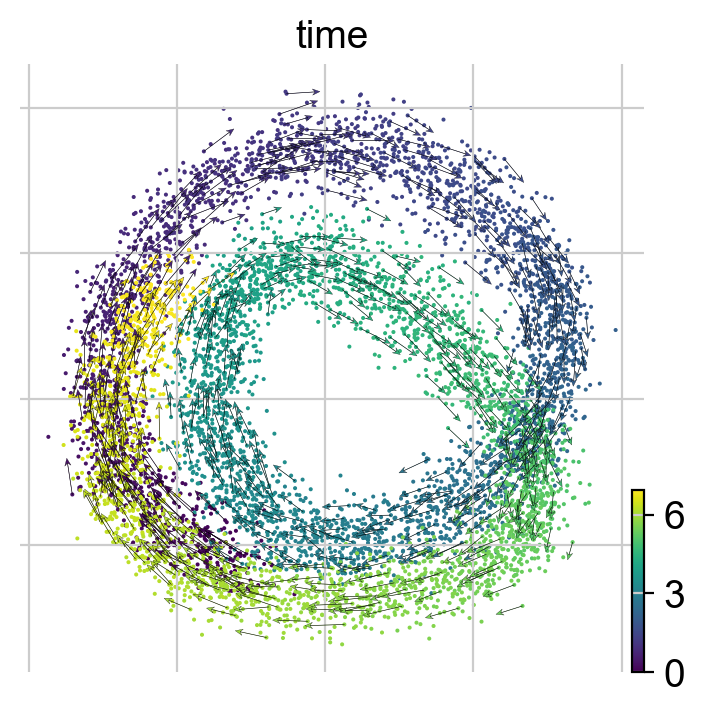

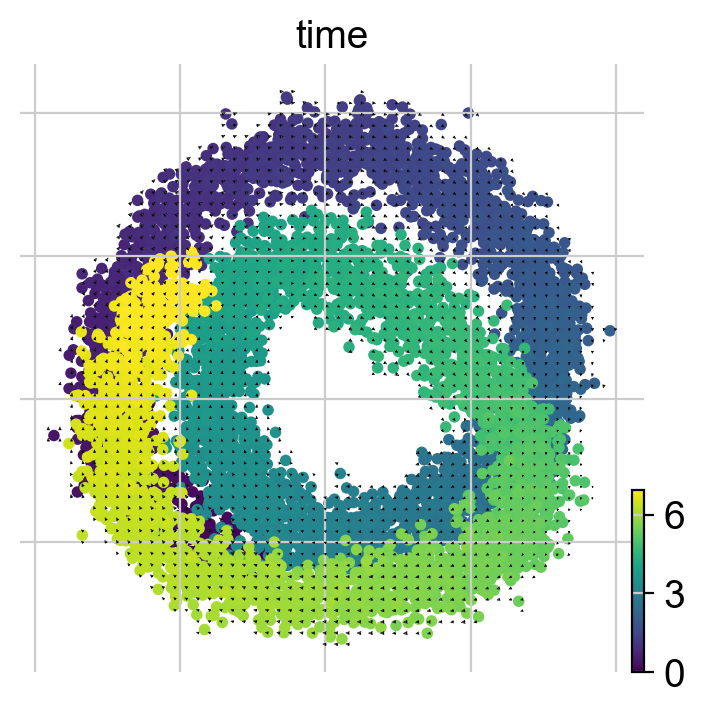

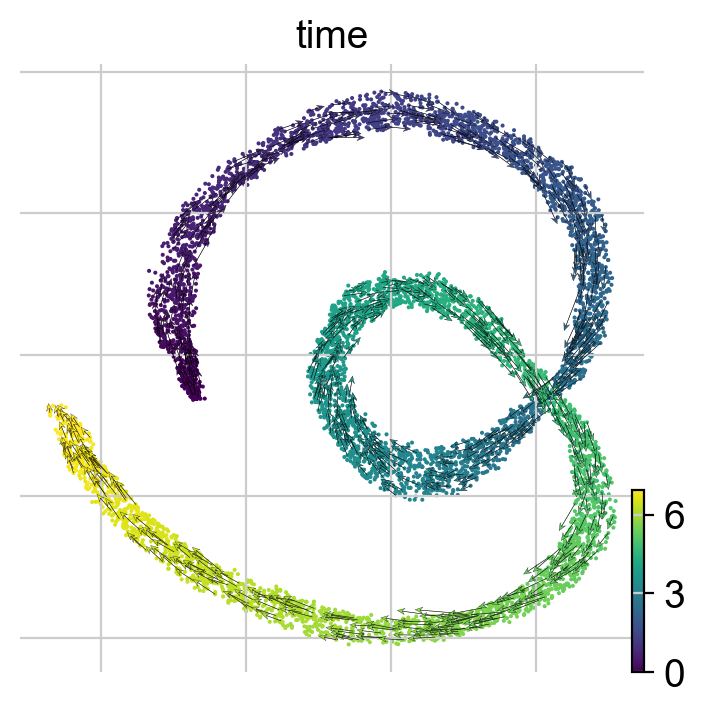

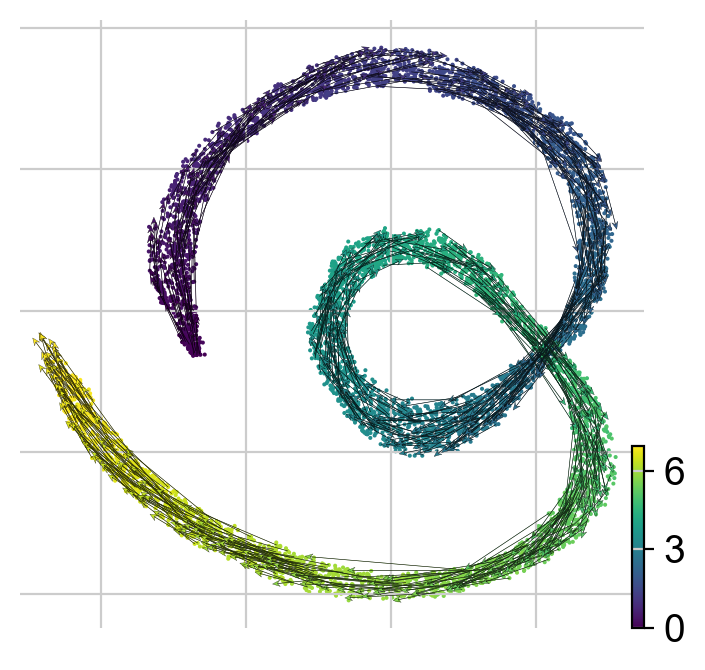

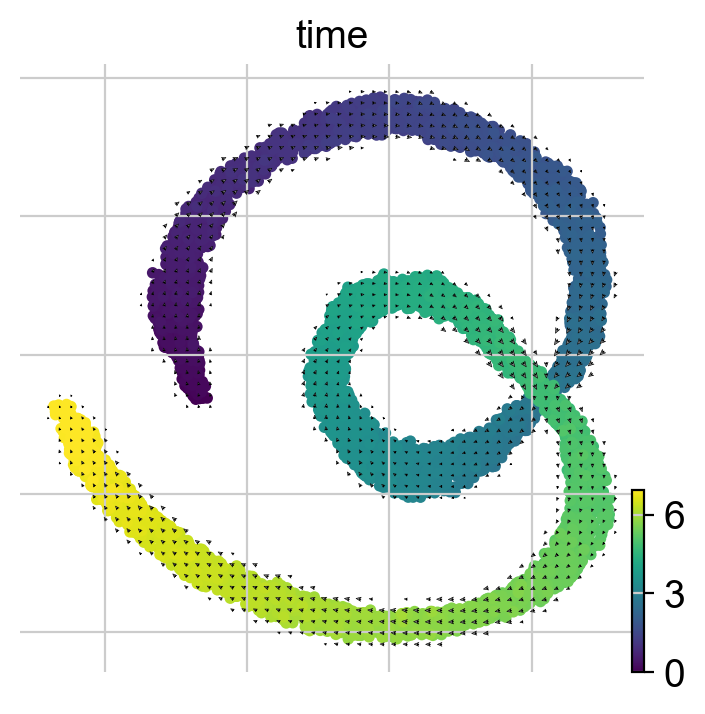

In [76]:
scv.pl.velocity_embedding(ydata, basis='pca2', color='time', dpi=100, density=0.1, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(ydata, basis='pca2', color='time', dpi=100, density=0.1, arrow_length=0.3, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_pca_exovelo_l2.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(ydata, basis='pca2', color='time', dpi=100, density=1.0, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(ydata, basis='umap2', color='time', dpi=100, density=0.1, arrow_length=0.3, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)
scv.pl.velocity_embedding(ydata, basis='umap2', color='time', dpi=100, density=0.1, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1, title="",)
plt.savefig(f"{save_dir}/simulation_umap_exovelo_l2.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(ydata, basis='umap2', color='time', dpi=100, density=1.0, arrow_size=2, show=False, color_map='viridis', colorbar=True, alpha=1)

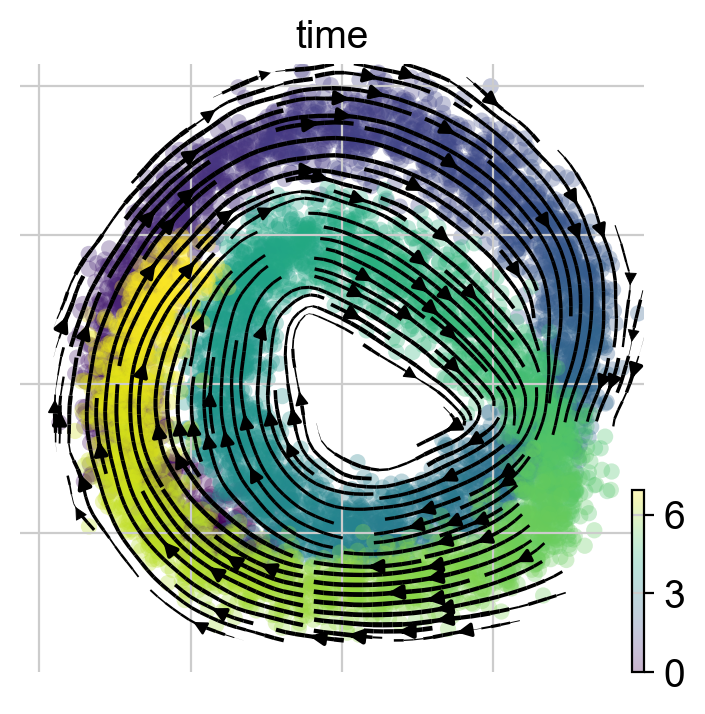

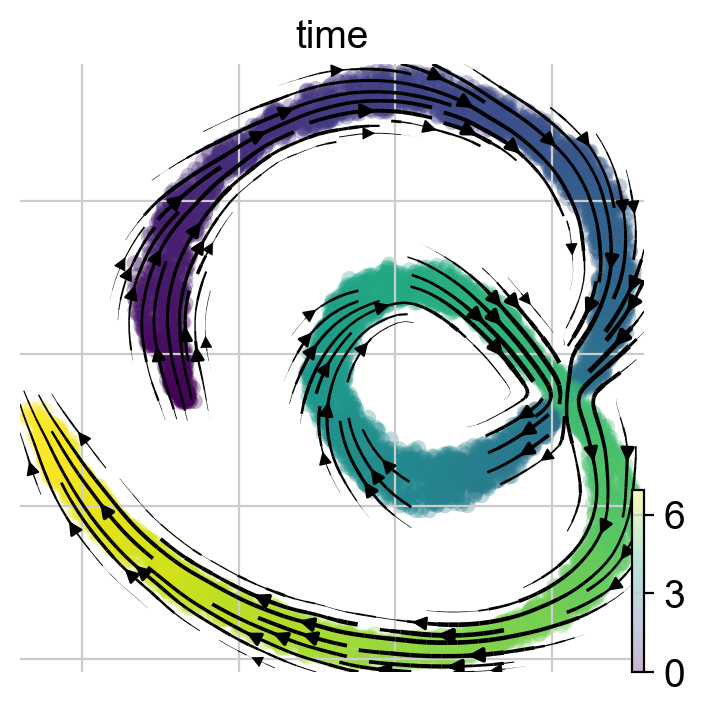

In [38]:
scv.pl.velocity_embedding_stream(ydata, basis='pca2', color='time', dpi=100, )
scv.pl.velocity_embedding_stream(ydata, basis='umap2', color='time', dpi=100, )

computing velocity graph (using 15/20 cores)


  0%|          | 0/7000 [00:00<?, ?cells/s]

/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound
/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import get_distribution, DistributionNotFound
/home/zelhar/micromamba/envs/exovelo/lib/python3.11/site-packages/louvain/__init__.py:54: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html.

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


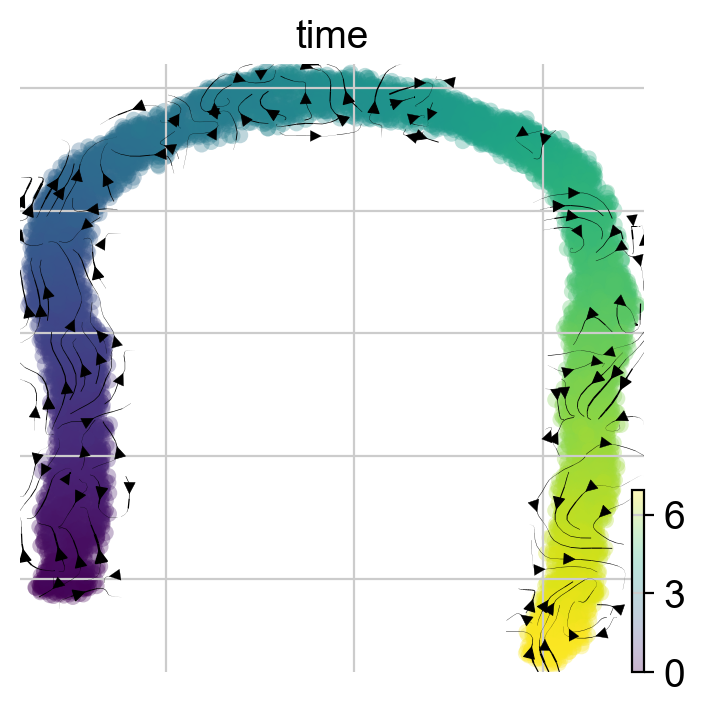

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umapx', embedded velocity vectors (adata.obsm)


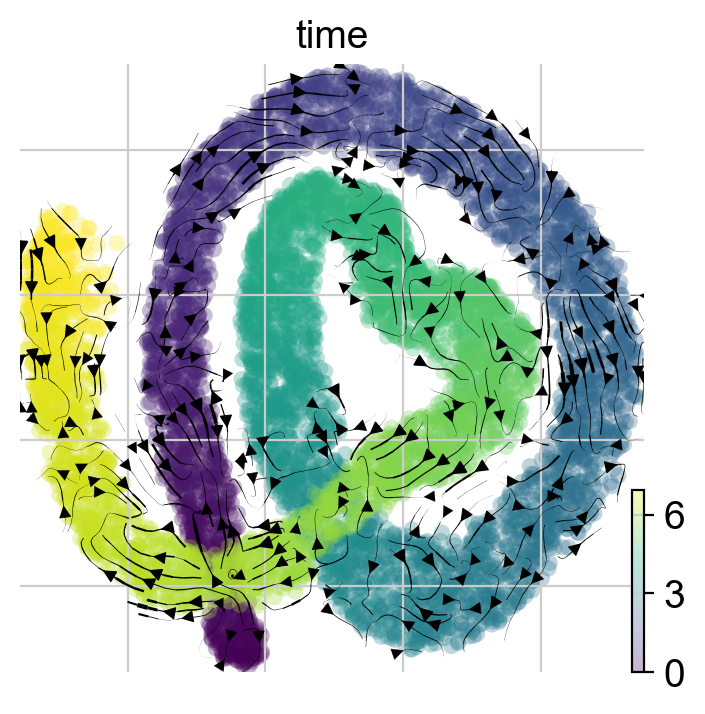

computing velocity graph (using 15/20 cores)


  0%|          | 0/7000 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


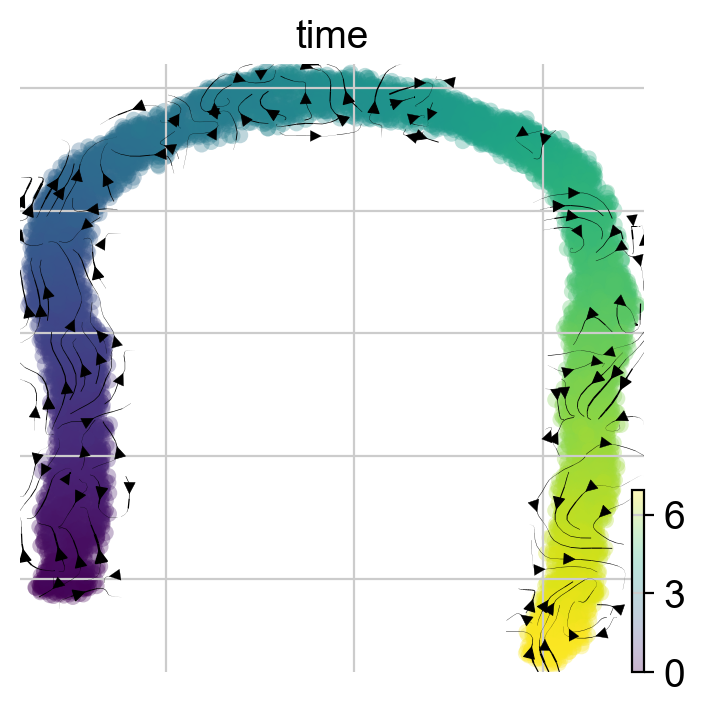

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umapy', embedded velocity vectors (adata.obsm)


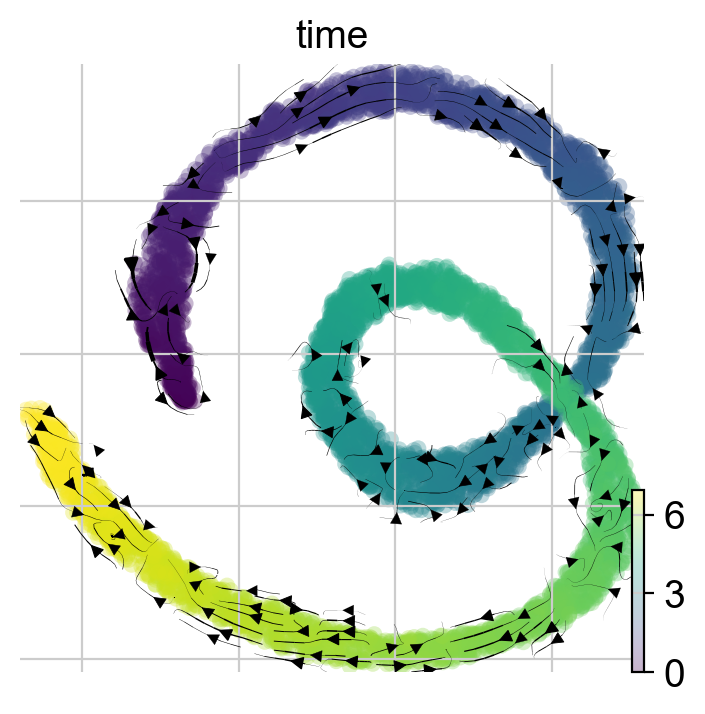

In [39]:
adata2.obsm['X_umapx'] = xdata.obsm['X_umap2'].copy()
scv.tl.velocity_graph(adata2, n_jobs=15)
scv.pl.velocity_embedding_stream(adata2, basis='umap', color='time', dpi=100)
scv.pl.velocity_embedding_stream(adata2, basis='umapx', color='time', dpi=100)

adata2.obsm['X_umapy'] = ydata.obsm['X_umap2'].copy()
scv.tl.velocity_graph(adata2, n_jobs=15)
scv.pl.velocity_embedding_stream(adata2, basis='umap', color='time', dpi=100)
scv.pl.velocity_embedding_stream(adata2, basis='umapy', color='time', dpi=100)

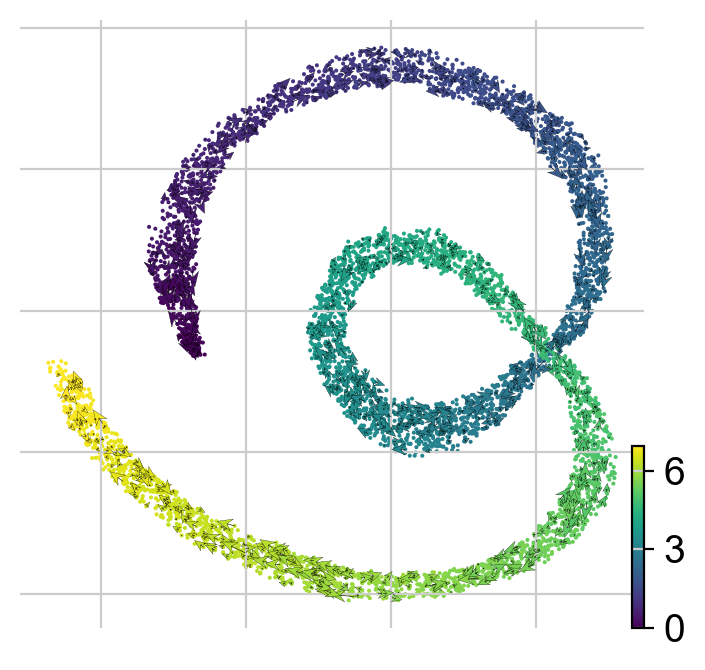

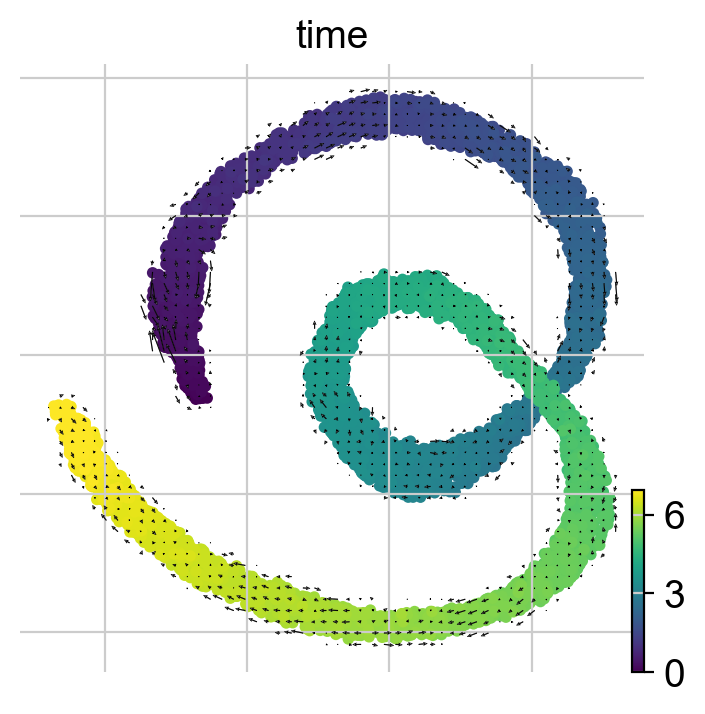

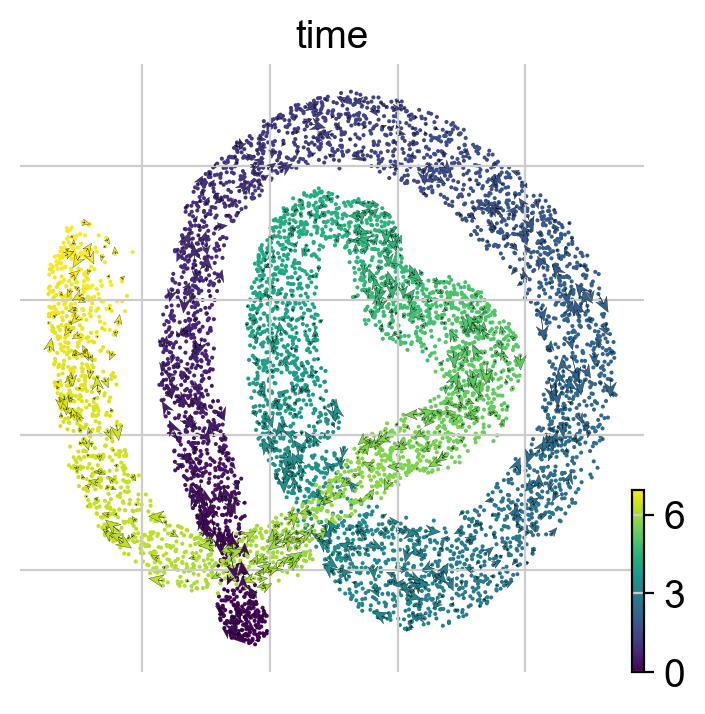

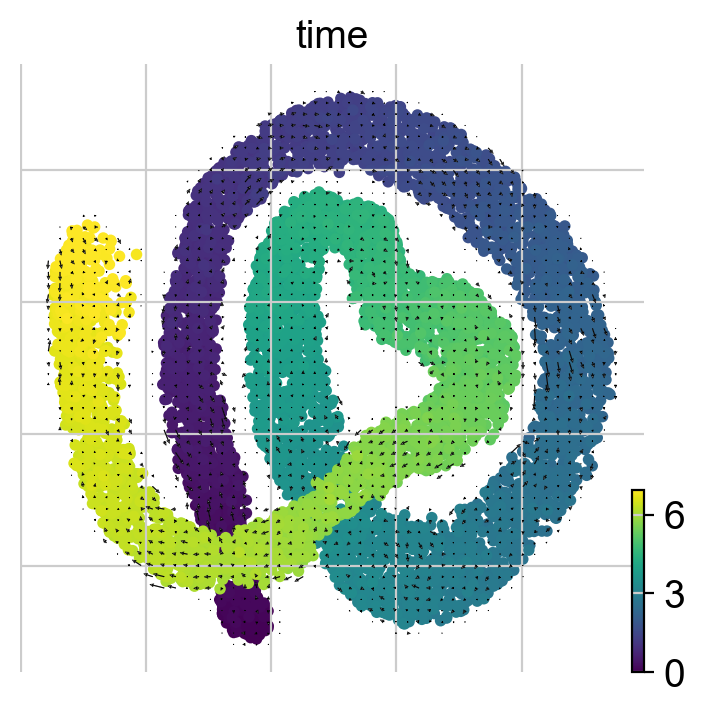

In [75]:
scv.pl.velocity_embedding(adata2, basis='umapy', color='time', arrow_size=4, arrow_length=5, dpi=100, density=0.152, show=False, color_map='viridis', colorbar=True, alpha=1, title="",)
plt.savefig(f"{save_dir}/simulation_umapy_scvelo.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(adata2, basis='umapy', color='time', dpi=100, density=1.0, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umapy_grid_scvelo.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )

scv.pl.velocity_embedding(adata2, basis='umapx', color='time', arrow_size=4, arrow_length=5, dpi=100, density=0.152, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umapx_scvelo.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )
scv.pl.velocity_embedding_grid(adata2, basis='umapx', color='time', dpi=100, density=1.0, show=False, color_map='viridis', colorbar=True, alpha=1)
plt.savefig(f"{save_dir}/simulation_umapx_grid_scvelo.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )

In [41]:
xdata

AnnData object with n_obs × n_vars = 7000 × 30
    obs: 'time', 'n_genes'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umap2', 'velocity_umap2', 'X_pca2', 'velocity_pca2'
    varm: 'PCs'
    layers: 'spliced', 'total', 'unspliced', 'v'
    obsp: 'distances', 'connectivities'

In [42]:
xdata.obs['time']
xdata.obsm['velocity_pca2'].shape

(7000, 6)

## gene plots

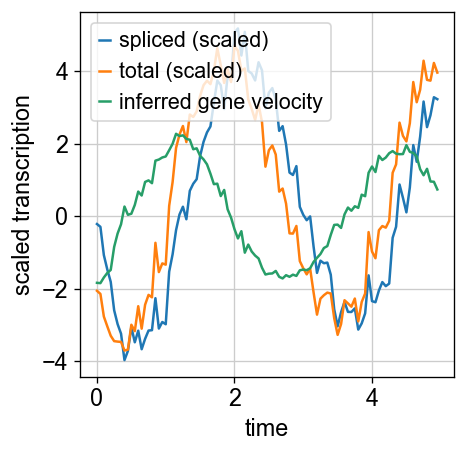

In [43]:
c = 100
s = Xp[:c,0]
r = Zp[:c,0]
ts = np.arange(len(s)) * dt
plt.plot(ts, s, label='spliced (scaled)')
plt.plot(ts, r, label='total (scaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

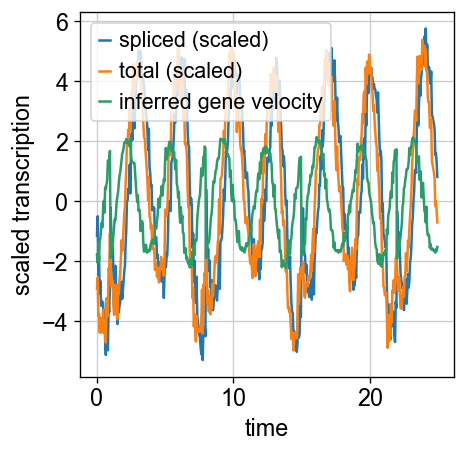

In [44]:
start = 2500
stop = 3000
s = Xp[start:stop,0]
r = Zp[start:stop,0]
ts = np.arange(len(s)) * dt
plt.plot(ts, s, label='spliced (scaled)')
plt.plot(ts, r, label='total (scaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

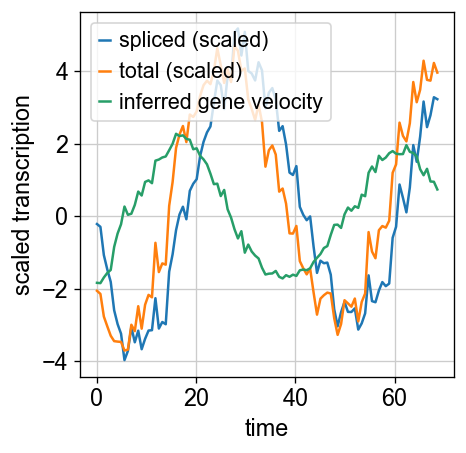

In [66]:
start = 0
stop = 100
s = Xp[start:stop,0]
r = Zp[start:stop,0]
ts = np.arange(len(s)) * dt
plt.plot(ts, s, label='spliced (scaled)')
plt.plot(ts, r, label='total (scaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

In [67]:
g, b
tau = np.log(2) / b
g, b, tau, dt, dt*40

(0.3333333333333333,
 1.0,
 0.6931471805599453,
 0.6931471805599453,
 27.725887222397812)

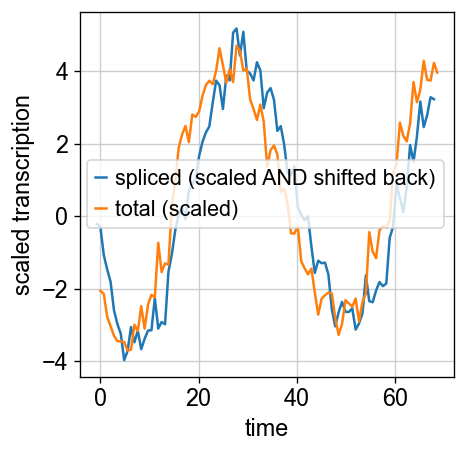

In [68]:
#plt.plot(ts, s, label='spliced (scaled)')
plt.plot(ts - tau, s, label='spliced (scaled AND shifted back)')
plt.plot(ts, r, label='total (scaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
plt.legend()
plt.savefig(f"{save_dir}/simulation_gene_velocity_shifted_by_spl_halflife.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

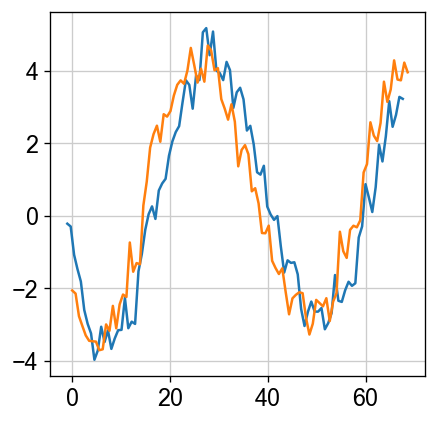

In [69]:
plt.plot(ts - tau / np.log(2), s, label='spliced (scaled AND shifted back)')
plt.plot(ts, r, label='total (scaled)')

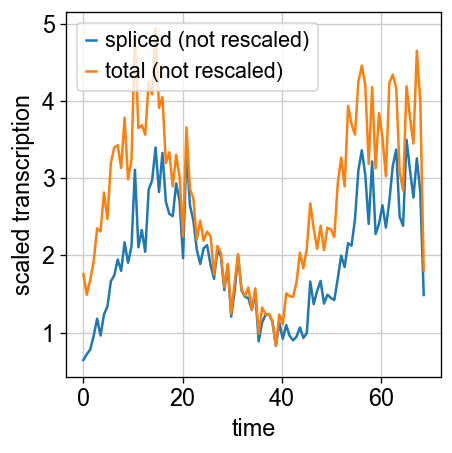

In [70]:
c = 100
s = adata.layers['spliced'][:c,0] 
r = adata.layers['total'][:c,0]
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b
plt.plot(ts - 0*tau, s, label='spliced (not rescaled)')
plt.plot(ts, r, label='total (not rescaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

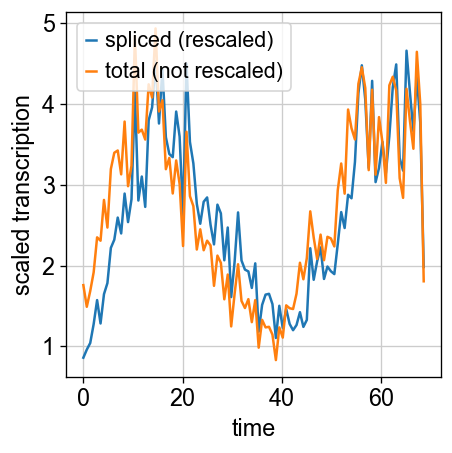

In [71]:
c = 100
s = adata.layers['spliced'][:c,0] * (1 + g / b)
r = adata.layers['total'][:c,0]
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b
plt.plot(ts - 0*tau, s, label='spliced (rescaled)')
plt.plot(ts, r, label='total (not rescaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

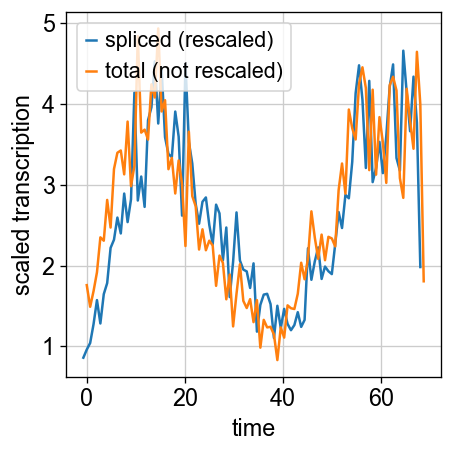

In [72]:
c = 100
s = adata.layers['spliced'][:c,0] * (1 + g / b)
r = adata.layers['total'][:c,0]
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b
plt.plot(ts - np.log(2)*tau, s, label='spliced (rescaled)')
plt.plot(ts, r, label='total (not rescaled)')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

In [73]:
dt = 0.05
ticks = [4,2,0,8,0,1,5,0]
a = np.repeat(
    ticks,
    [10,]*len(ticks),
)
r0=0
n = len(a) + 1
g = 0.5 * 8
g = 1
g = 0.15
g=1 / 3
b = 1.0
t = np.cumsum(np.repeat((0,dt), (1,n-1)))

In [52]:
beta = b
gamma = g
alpha = a
dt=0.25
dt = 1 / b * np.log(2)
s, r, u = simutils.generateMRNA(alpha,beta,gamma,dt,0,0, n, zinf=0.2, dif=1e-4, rate_distort=True)
s, r, u = simutils.generateMRNA(alpha,beta,gamma,dt,0,0, n, zinf=0.0, dif=0.0, rate_distort=False)
#adata = simutils.simulateGenes(n_genes=n_genes, n_repeats=n_repeats, a=a, b=b, g=g, s0=0, u0=0, n=n, dt=dt, zinf=0.2, dif=1e-4, rscale=False, rate_distort=True)

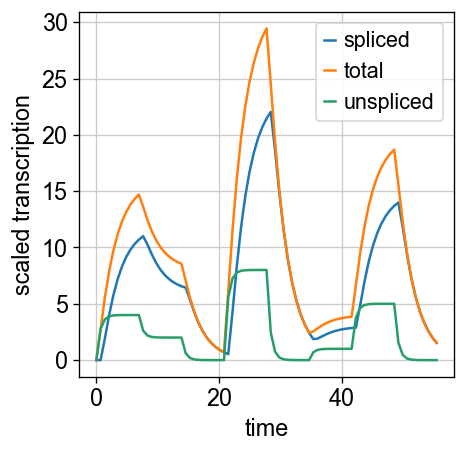

In [53]:
c = 100
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b
plt.plot(ts, s, label='spliced')
plt.plot(ts, r, label='total')
plt.plot(ts, u, label='unspliced')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

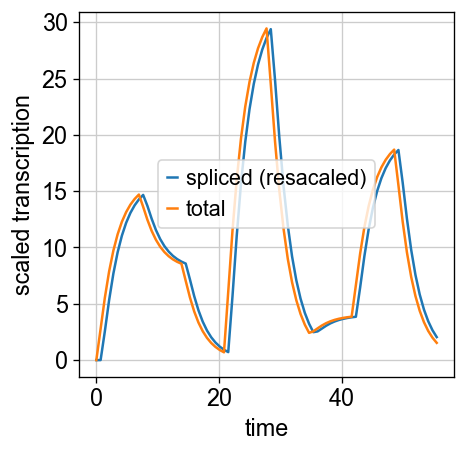

In [54]:
c = 100
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b
plt.plot(ts, s * (1 + g/b), label='spliced (resacaled)')
plt.plot(ts, r, label='total')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

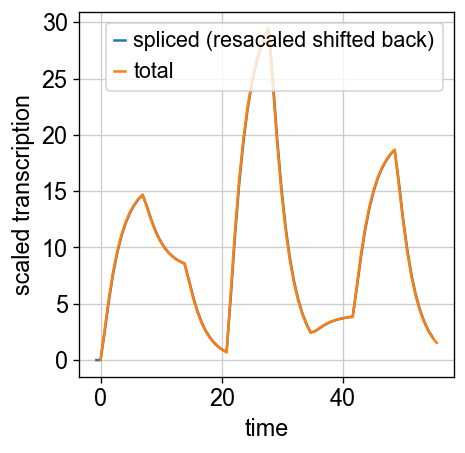

In [55]:
c = 100
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b * np.log(2)
plt.plot(ts - tau, s * (1 + g/b), label='spliced (resacaled shifted back)')
plt.plot(ts, r, label='total')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

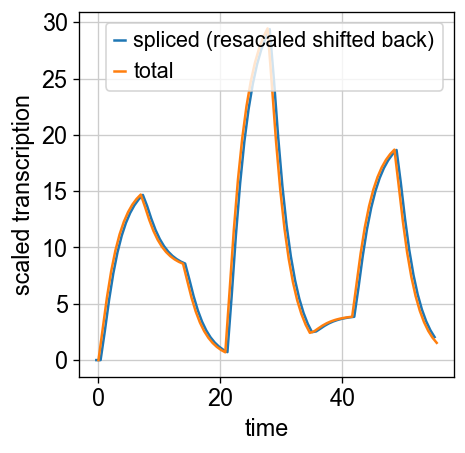

In [56]:
c = 100
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b * np.log(2) * 0.5
plt.plot(ts - tau, s * (1 + g/b), label='spliced (resacaled shifted back)')
plt.plot(ts, r, label='total')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

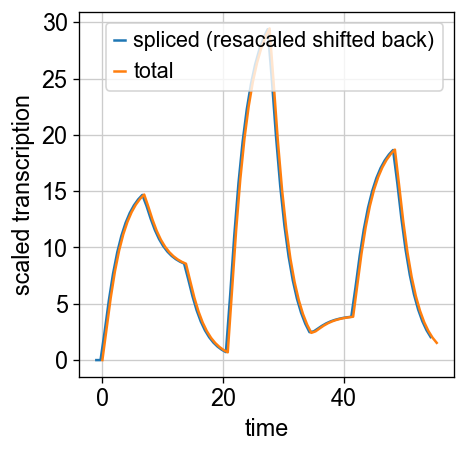

In [57]:
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b * np.log(2)
tau = 1/b
plt.plot(ts - tau, s * (1 + g/b), label='spliced (resacaled shifted back)')
plt.plot(ts, r, label='total')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

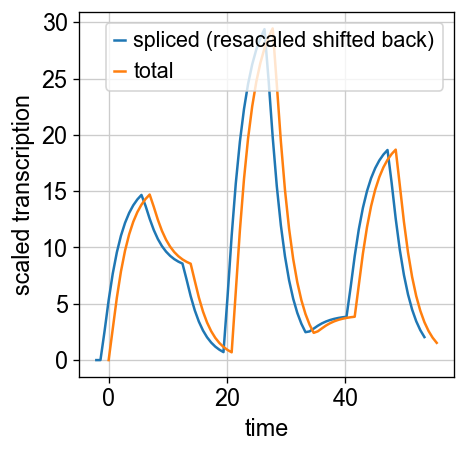

In [58]:
c = 100
ts = np.arange(len(s)) * dt
tau = np.log(2)/b
tau = 1/b * np.log(2)
tau = 1/b
tau = 1/g * np.log(2)
plt.plot(ts - tau, s * (1 + g/b), label='spliced (resacaled shifted back)')
plt.plot(ts, r, label='total')
plt.xlabel('time')
plt.ylabel('scaled transcription')
#plt.plot(ts, r-s, label='inferred gene velocity')
plt.legend()
#plt.savefig(f"{save_dir}/simulation_gene_velocity.pdf", dpi=300, bbox_inches='tight', transparent=True, backend='cairo', )

Text(0, 0.5, 'scaled transcription')

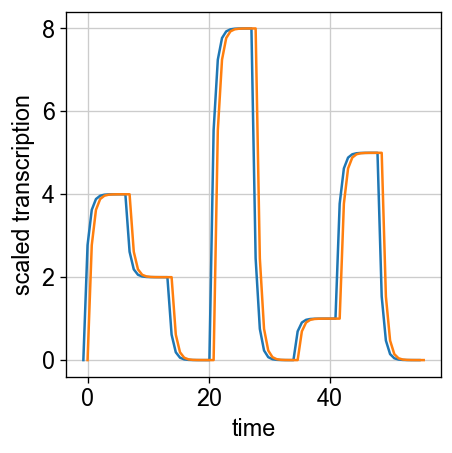

In [59]:
tau = 1/b * np.log(2)
plt.plot(ts - tau, u, label='unspliced (shifted back)')
plt.plot(ts, u, label='unspliced')
plt.xlabel('time')
plt.ylabel('scaled transcription')

In [60]:
1 - np.log(2)

0.3068528194400547

In [61]:
np.log(2)

0.6931471805599453

In [62]:
k=8 #default
k=16 #default
k=30 #default
tree = BallTree(Xp, metric='minkowski', p=2)
_, ind_future = tree.query(Zp[:,:], k=k)
_, ind_past = tree.query(Xp[:,:], k=k)

[]

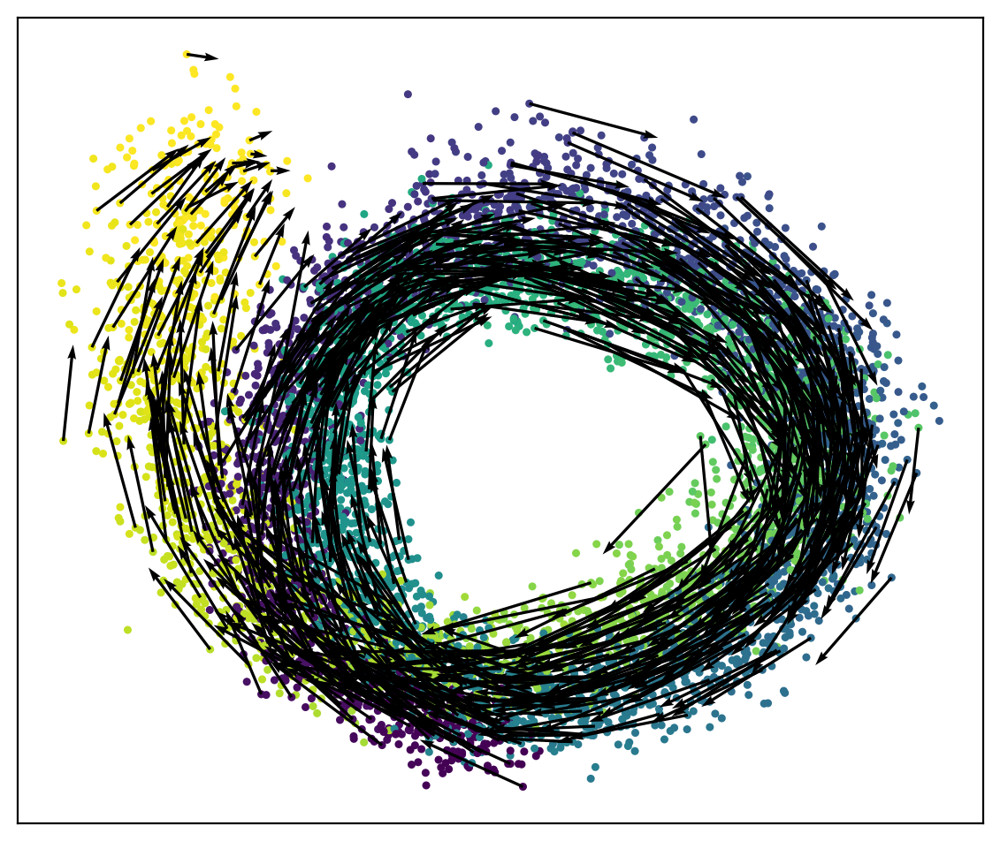

In [63]:
# EXO-velol projection but with total RNA as future modality (instead of unspliced) 
mask = np.random.rand(len(Xp)) >= 0
x = Xp
v = Xp[ind_future].mean(1) - Xp[ind_past].mean(1)
fig, ax = plt.subplots(dpi=100, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
#ax.scatter(Yp[:,0], Yp[:,1], s=5,)
#ax.colorbar(label='time')
#ax.legend()
mask = np.random.rand(len(Xp)) < 1e-1
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    v[:, 0][mask],
    v[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)
ax.set_xticks([])
ax.set_yticks([])

In [64]:
# EXO-velol projection but with total RNA as future modality (instead of unspliced) 
n_obs = adata.n_obs
#projection = UMAP(n_neighbors=25, init='pca', min_dist=1.25, spread=2).fit(np.concatenate((Xp,Zp), axis=0))
projection = UMAP(n_neighbors=25, init='pca', min_dist=1.25, spread=2).fit(Xp, axis=0)

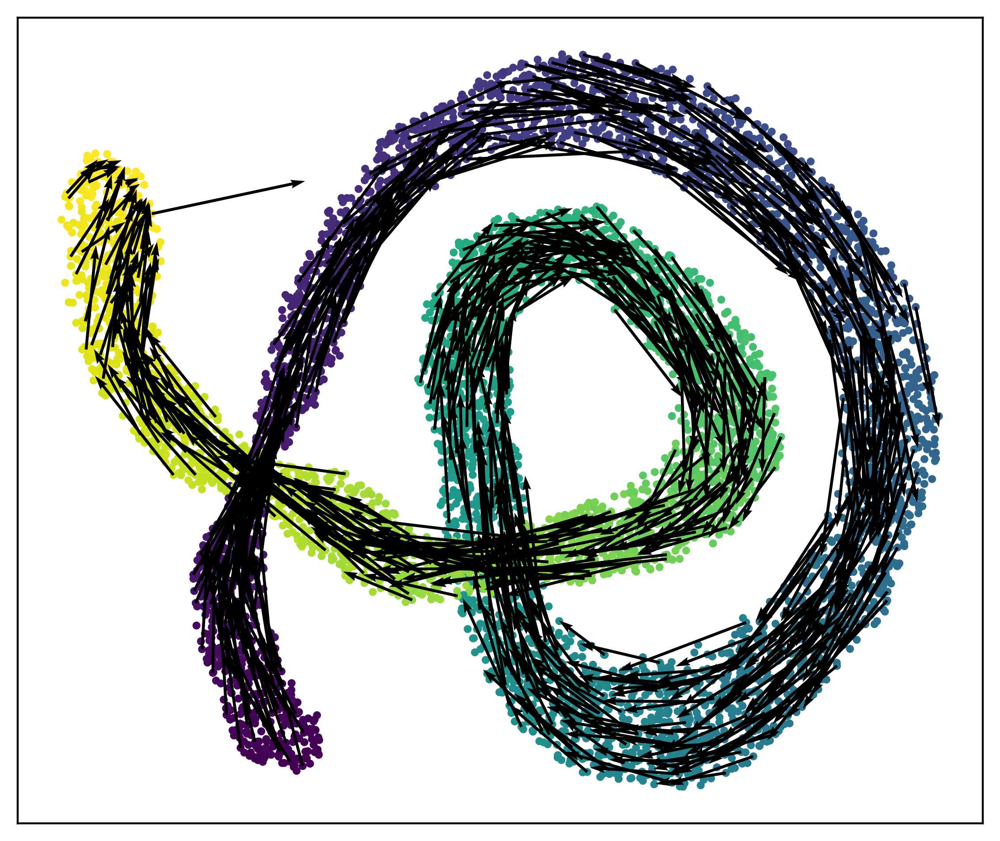

In [65]:
x = projection.transform(Xp)
k_nn = 8
k_nn = 25
k_nn = 10
mask = np.random.rand(len(Xp)) >= 0
v = Xp[ind_future].mean(1) - Xp[ind_past].mean(1)
#v = Xp[ind_future[:,1:]].mean(1) - Xp[ind_past[:,1:]].mean(1)
#v = Xp[ind_future[:,:k_nn]].mean(1) - Xp[ind_past[:,:k_nn]].mean(1)
v = x[ind_future[:,:k_nn]].mean(1) - x[ind_past[:,:k_nn]].mean(1)
fig, ax = plt.subplots(dpi=200, figsize=(7,6), nrows=1, ncols=1)
ax.scatter(x[:,0], x[:,1], c=adata.obs['time'], s=5,)
#ax.scatter(Yp[:,0], Yp[:,1], s=5,)
#ax.colorbar(label='time')
#ax.legend()
mask = np.random.rand(len(Xp)) < 1e-1
ax.quiver(
    x[:, 0][mask],
    x[:, 1][mask],
    v[:, 0][mask],
    v[:, 1][mask],
    angles="xy",
    scale_units="xy",
    color="black",
    scale=1e-0,
    width=3e-3,
    #headwidth=6,
    #headlength=6,
)
ax.set_xticks([])
ax.set_yticks([])
plt.savefig(f"{save_dir}/simulation_exo-velo-umap-projection.pdf", dpi=100, bbox_inches='tight', transparent=True, backend='cairo', )